# UMC 301: Applied Data Science and Artificial Intelligence
## Assignment 2

### Submission instructions:

1.   The assignment is to be submitted in ONE single notebook.
2.   Submit the .ipynb file and pdf of the same with all cells open through this Teams Assignment.
3. If your IISc email ID is < username > @iisc.ac.in, then name the file < username >_Assgn_2. E.g. jonathan_Assgn_1a for email ID jonathan@iisc.ac.in.
4. Before submission, execute the ’Restart session and run all’ option from the Runtime/Kernel tab. Verify that there are no errors and that you are getting the output you expect.
5. Use the dataset(Q1,Q2) : https://www.dropbox.com/scl/fi/7m0pt1dkmwbkr3byv5r2j/face_images.zip?rlkey=r2gqsdvuyvpqqk4a7bjd9kcvv&st=nj7wl35d&dl=1
6. Use the dataset(Q3) : https://www.kaggle.com/datasets/sbaghbidi/human-faces-object-detection/data (Human face object detection)

**Data Files for Q1,Q2**

**face_images** : All the face images, cropped and aligned. <br>
**face_image_attr.csv**: Attribute labels for each image. There are 40 attributes. "1" represents positive while "-1" represents negative.

**Data Files for Q3**

**images** : A diverse compilation of human facial images. <br>
**faces.csv**: Height, Width are Image dimensions, x0,y0 are upper left corner and x1,y1 are bottom right corner of the bounding box


# Question 1
Train a ResNet18 model on the above dataset(face images) to classify the "Arched_Eyebrows" attribute. Apply appropriate data pre-processing [you can use less datapoints]. Evaluate the model by calculating precision, accuracy, F1 score, ROC curve, confusion matrix, and other relevant metrics. Do experiments with different hyperparameters and discuss about results. <br>
[Note: Marks will be given based on different experiments and discussion]

### Import all the packages and the GPU

In [14]:
# import all the necessary packages
import os # for file handling
import sys # for printing to stderr
import time # for timing
import json # for reading json files
import requests # for making http requests
import argparse # for parsing command line arguments
from torch.utils.data import Subset # for splitting the dataset
import csv # for reading csv files
import datetime # for handling dates
import numpy as np # for numerical operations
import pandas as pd # for data manipulation
import torchvision # for computer vision
from torchvision import transforms # for image transformations
import torchvision.datasets as datasets # for loading datasets
from torch.utils.data import Dataset, DataLoader # for creating custom datasets
import torch # PyTorch
import torch.nn as nn # PyTorch's neural network module
import torch.nn.functional as F # PyTorch's functional module
import matplotlib.pyplot as plt # for plotting
import torch.optim as optim # PyTorch's optimization module
import torch.utils.data as data # PyTorch's data module
from torch.autograd import Variable # for gradients
from sklearn.preprocessing import MinMaxScaler # for normalization
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_curve, auc, confusion_matrix # for evaluation
from PIL import Image # for image processing
import seaborn as sns # for plotting
from torchvision import models # for pre-trained models
import warnings # for ignoring warnings
warnings.filterwarnings("ignore") # ignore warnings
from torchinfo import summary # for model summary
from tqdm import tqdm # for progress bars
import matplotlib.pyplot as plt # for plotting
import zipfile # for extracting zip files
import math # for mathematical operations
from torchinfo import summary # for model summary
from torchvision.models import resnet18, ResNet18_Weights # for ResNet18

In [15]:
# Check if GPU is available and assign device to it

device = torch.device("cuda" if torch.cuda.is_available() else "cpu") # assign device
print("Device: ", torch.cuda.get_device_name(0) if torch.cuda.is_available() else "CPU") # print device

# If GPU is not available, print a warning message
if torch.cuda.is_available() == False:
    print("WARNING: GPU not available. Training will be slow. The system might run out of memory.")

Device:  NVIDIA GeForce GTX 1660 SUPER


### Download and extract the Data

In [ ]:
# URL of the ZIP file
url = "https://www.dropbox.com/scl/fi/7m0pt1dkmwbkr3byv5r2j/face_images.zip?rlkey=r2gqsdvuyvpqqk4a7bjd9kcvv&st=nj7wl35d&dl=1"

os.makedirs("Data", exist_ok=True) # create the folder if it doesn't exist

# Download the ZIP file with progress bar
response = requests.get(url, stream=True) # make a GET request
total_size = int(response.headers.get('content-length', 0)) # get the total file size

zip_path = os.path.join("Data", "face_images.zip") # path to save the ZIP file
with open(zip_path, "wb") as file, tqdm( # open the file and create a progress bar
    desc="Downloading",
    total=total_size,
    unit='iB',
    unit_scale=True,
    unit_divisor=1024,
) as progress_bar: # as progress_bar
    for data in response.iter_content(chunk_size=1024): # iterate over the response
        size = file.write(data) # write the data to the file
        progress_bar.update(size) # update the progress bar

# Extract the ZIP file with progress bar
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    total_files = len(zip_ref.infolist())
    for file in tqdm(zip_ref.infolist(), desc="Extracting", total=total_files):
        zip_ref.extract(file, "Data") # extract the file to the folder

# Remove the ZIP file after extraction
os.remove(zip_path)

print("Download and extraction completed. Files are in the 'Data' folder.") # print message

In [17]:
# The csv file containing the image labels

csv_file_1 = pd.read_csv('Data/face_image_attr.csv') # read the csv file
csv_file_2 = pd.read_csv('Data/face_image_eval_partition.csv') # read the csv file

# The directory containing the images

dir_1 = './Data/face_images/img_align_celeba' # directory containing the images

In [18]:
# Find the numner of rows and columns in the dataset and the number of images in the directory.
# If they match, then the dataset is consistent with the images. Else print a warning message.

if len(csv_file_1) == len(os.listdir(dir_1)) == len(csv_file_2): # Check if the number of rows in the dataset is equal to the number of images in the directory
    print("The dataset is consistent with the images.") # If yes, then print a message saying that the dataset is consistent with the images.
else:
    print("Warning: The dataset is not consistent with the images.") # If no, then print a warning message.
    raise Exception("Please check the dataset and the images.") # Raise an exception

# Check if any of the images are corrupted. If yes, then print a warning message along with the number of corrupted images.
# If no, then print a message saying that there are no corrupted images.

corrupted_images = 0
for img in os.listdir(dir_1): # Loop through all the images in the directory
    try:
        img = Image.open(os.path.join(dir_1, img)) # Open the image
        img.verify() # Verify the image
    except (IOError, SyntaxError) as e: # If the image is corrupted
        corrupted_images += 1 # Increment the number of corrupted images
if corrupted_images > 0: # If there are corrupted images
    print("Warning: There are", corrupted_images, "corrupted images.") # Print a warning message along with the number of corrupted images
    raise Exception("Please remove the corrupted images.") # Raise an exception
else:
    print("There are no corrupted images.") # If there are no corrupted images, then print a message saying that there are no corrupted images.

# Check if any of t he labels is NAN. If yes, then print a warning message along with the number of NAN labels.
# If no, then print a message saying that there are no NAN labels.

nan_labels_1 = csv_file_1.isnull().sum().sum() # Check if there are any NAN labels in the first csv file
nan_labels_2 = csv_file_2.isnull().sum().sum() # Check if there are any NAN labels in the second csv file
if nan_labels_1 or nan_labels_2 > 0:
    print("Warning: There are NAN labels.") # If there are NAN labels, then print a warning message
    raise Exception("Please remove the NAN labels.") # Raise an exception
else:
    print("There are no NAN labels.") # If there are no NAN labels, then print a message saying that there are no NAN labels.

The dataset is consistent with the images.
There are no corrupted images.
There are no NAN labels.


In [19]:
print("Number of images in the directory:", len(os.listdir(dir_1))) # Print the number of images in the directory

Number of images in the directory: 202599


In [20]:
class CustomImageDataset(Dataset): # Create a custom dataset class
    def __init__(self, img_dir, csv_file_1, csv_file_2, transform=None): # Initialize the class
        self.img_dir = img_dir # Directory containing the images
        self.transform = transform or transforms.Compose([ # Image transformations
            transforms.Resize((224, 224)),  # Resize images to a standard size 224x224
            transforms.ToTensor(),  # Convert image to PyTorch tensor
            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize with ImageNet stats
        ])
        
        # Read CSV files
        df1 = pd.read_csv(csv_file_1) # Read the first csv file
        df2 = pd.read_csv(csv_file_2) # Read the second csv file
        
        # Merge dataframes on image_id
        self.data = pd.merge(df1[['image_id', 'Arched_Eyebrows']],  # Merge the dataframes on image_id
                             df2[['image_id', 'partition']],  # Select the columns to merge
                             on='image_id') # Merge on image_id
        
    def __len__(self): # Define the length of the dataset
        return len(self.data) # Return the length of the dataset
    
    def __getitem__(self, idx): # Get an item from the dataset
        image_id = self.data.iloc[idx, 0] # Get the image_id
        img_name = os.path.join(self.img_dir, image_id) # Get the image name
        image = Image.open(img_name).convert('RGB')  # Ensure image is in RGB format
        
        arched_eyebrows = self.data.iloc[idx, 1] # Get the label
        partition = self.data.iloc[idx, 2] # Get the partition
        
        image = self.transform(image) # Apply transformations to the image
        
        return image, arched_eyebrows, partition, image_id # Return the image, label, partition, and image_id
    
# Create the dataset
dataset = CustomImageDataset(img_dir='Data/face_images/img_align_celeba', csv_file_1='Data/face_image_attr.csv', csv_file_2 = 'Data/face_image_eval_partition.csv')

In [21]:
print(len(dataset)) # Print the length of the dataset

print("*"*50, "This script needs to be executed only once after the execution of the previous script", "*"*50)
print("*"*50,  "If an error is found, rerun the script after executing the previous script again.", "*"*50)

# Make a list of image_id where Arched_Eyebrows is 1 and -1
arched_eyebrows_1 = dataset.data[dataset.data['Arched_Eyebrows'] == 1]['image_id'].tolist() # List of image_id where Arched_Eyebrows is 1
print("Arched_evebrow_1_prev_list = ", len(arched_eyebrows_1)) # Print the number of images where Arched_Eyebrows is 1
arched_eyebrows_minus_1 = dataset.data[dataset.data['Arched_Eyebrows'] == -1]['image_id'].tolist() # List of image_id where Arched_Eyebrows is -1
print("Arched_evebrow_minus_1_prev_list = ", len(arched_eyebrows_minus_1)) # Print the number of images where Arched_Eyebrows is -1

# For each Arched_Eyebrows value, convert -1 to 0
dataset.data['Arched_Eyebrows'] = dataset.data['Arched_Eyebrows'].apply(lambda x: 0 if x == -1 else x) # Convert -1 to 0

# Make a list of image_id where Arched_Eyebrows is 1 and 0
arched_eyebrows_1_new = dataset.data[dataset.data['Arched_Eyebrows'] == 1]['image_id'].tolist() # List of image_id where Arched_Eyebrows is 1
print("Arched_evebrow_1_new_list = ", len(arched_eyebrows_1_new)) # Print the number of images where Arched_Eyebrows is 1
arched_eyebrows_0 = dataset.data[dataset.data['Arched_Eyebrows'] == 0]['image_id'].tolist() # List of image_id where Arched_Eyebrows is 0
print("Arched_evebrow_0_list = ", len(arched_eyebrows_0)) # Print the number of images where Arched_Eyebrows is 0

# Check if the number of images with Arched_Eyebrows = 1 and Arched_Eyebrows = 0 are equal to their corresponding previous images

if len(arched_eyebrows_1) == len(arched_eyebrows_1_new) and len(arched_eyebrows_minus_1) == len(arched_eyebrows_0):
    print("Labelling to 0 and 1 is consistent.") # If yes, then print a message saying that the labelling is consistent
else:
    print("Labelling to 0 and 1 is not consistent.") # If no, then print a message saying that the labelling is not consistent
    raise ValueError("Labelling to 0 and 1 is not consistent.") # Raise an error

202599
************************************************** This script needs to be executed only once after the execution of the previous script **************************************************
************************************************** If an error is found, rerun the script after executing the previous script again. **************************************************
Arched_evebrow_1_prev_list =  54090
Arched_evebrow_minus_1_prev_list =  148509
Arched_evebrow_1_new_list =  54090
Arched_evebrow_0_list =  148509
Labelling to 0 and 1 is consistent.


In [22]:
# partition = 0 for dataset[0] until dataset[162769] - train set
# partition = 1 for dataset[162770] until dataset[182636] - test set
# partition = 2 for dataset[182637] until dataset[202598] - validation set

# Define the indices for each partition
train_indices = list(range(0, 162770))
test_indices = list(range(162770, 182637))
validation_indices = list(range(182637, 202599))

# Create Subset datasets
train_dataset = Subset(dataset, train_indices)
test_dataset = Subset(dataset, test_indices)
validation_dataset = Subset(dataset, validation_indices)

# Print the sizes of each partition to verify
print(f"Training set size: {len(train_dataset)}")
print(f"Test set size: {len(test_dataset)}")
print(f"Validation set size: {len(validation_dataset)}")

Training set size: 162770
Test set size: 19867
Validation set size: 19962


In [23]:
batch_size = 32 # batch size
learning_rate = 0.001 # learning rate
num_epochs = 2 # number of epochs

In [24]:
main_model = models.resnet18(pretrained=True) # Load the pre-trained ResNet-18 model

In [25]:
def train_model(model, train_dataset, val_dataset, num_epochs, batch_size, learning_rate):
   
    # Create data loaders
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
    
    # Replace the last fully connected layer
    num_ftrs = model.fc.in_features # Number of input features for the fully connected layer
    model.fc = nn.Linear(num_ftrs, 1)  # Binary classification
    
    # Move model to device
    model = model.to(device) # Move the model to the device
    
    # Define loss function and optimizer
    criterion = nn.BCEWithLogitsLoss() # Binary cross-entropy loss
    optimizer = optim.Adam(model.parameters(), lr=learning_rate) # Adam optimizer
    
    # Lists to store losses and times for plotting
    train_losses = []
    val_losses = []
    times = []
    start_time = time.time()
    
    # Training loop
    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0
        
        for images, labels, _, _ in tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs}"): #
            images = images.to(device) # Move images to device
            labels = labels.float().to(device) # Move labels to device
            optimizer.zero_grad() # Zero the gradients
            outputs = model(images) # Forward pass
            loss = criterion(outputs.squeeze(), labels) # Calculate loss
            loss.backward() # Backward pass
            optimizer.step() # Update weights
            running_loss += loss.item() * images.size(0) # Update running loss
        epoch_loss = running_loss / len(train_dataset) # Calculate epoch loss
        train_losses.append(epoch_loss) # Append to list
        
        # Validation
        model.eval()
        val_loss = 0.0
        correct = 0
        total = 0
        
        with torch.no_grad(): # No need to calculate gradients
            for images, labels, _, _ in val_loader: # Loop through validation set
                images = images.to(device) # Move images to device
                labels = labels.float().to(device) # Move labels to device
                outputs = model(images) # Forward pass
                loss = criterion(outputs.squeeze(), labels) # Calculate loss
                val_loss += loss.item() * images.size(0) # Update validation loss
                predicted = torch.round(torch.sigmoid(outputs.squeeze())) # Round the output to 0 or 1
                total += labels.size(0) # Update total
                correct += (predicted == labels).sum().item() # Update correct
        
        val_loss = val_loss / len(val_dataset) # Calculate validation loss
        val_losses.append(val_loss) # Append to list
        accuracy = correct / total # Calculate accuracy
        
        # Record time
        times.append(time.time() - start_time)
        
        print(f"Epoch {epoch+1}/{num_epochs}")
        print(f"Train Loss: {epoch_loss:.4f}")
        print(f"Val Loss: {val_loss:.4f}")
        print(f"Val Accuracy: {accuracy:.4f}")
        print()
    
    # Plot losses
    plt.figure(figsize=(12, 6))
    plt.plot(times, train_losses, label='Training Loss')
    plt.plot(times, val_losses, label='Validation Loss')
    plt.xlabel('Training Time (seconds)')
    plt.ylabel('Loss')
    
    # Create title with hyperparameters
    title = f'Training and Validation Loss over Time\n'
    title += f'Batch Size: {batch_size}, Epochs: {num_epochs}, Learning Rate: {learning_rate}'
    plt.title(title)
    
    plt.legend()
    plt.tight_layout()  # Adjust layout to prevent clipping of labels
    plt.show()

    return model

In [26]:
def fine_tune_model(model, train_dataset, val_dataset, num_epochs, batch_size, learning_rate):
    model.to(device) # Move model to device

    # Fine-tune the last layer for a few epochs
    model = train_model(model, train_dataset, validation_dataset, num_epochs, batch_size, learning_rate)

    # Unfreeze all layers and fine-tune the entire model for a few more epochs

    for param in model.parameters():
        param.requires_grad = True

    # Train the entire model for a few more epochs
    model = train_model(model, train_dataset, validation_dataset, num_epochs, batch_size, learning_rate/10)

    return model

Epoch 1/2: 100%|██████████| 5087/5087 [10:35<00:00,  8.01it/s]


Epoch 1/2
Train Loss: 0.3523
Val Loss: 0.3518
Val Accuracy: 0.8284



Epoch 2/2: 100%|██████████| 5087/5087 [10:38<00:00,  7.97it/s]


Epoch 2/2
Train Loss: 0.3318
Val Loss: 0.3423
Val Accuracy: 0.8336



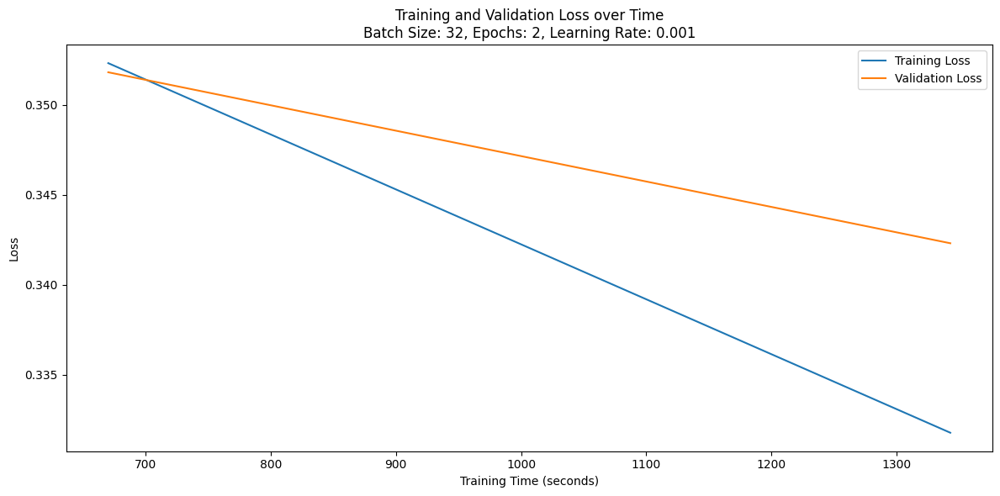

Epoch 1/2: 100%|██████████| 5087/5087 [10:40<00:00,  7.94it/s]


Epoch 1/2
Train Loss: 0.3043
Val Loss: 0.3341
Val Accuracy: 0.8387



Epoch 2/2: 100%|██████████| 5087/5087 [10:37<00:00,  7.98it/s]


Epoch 2/2
Train Loss: 0.2904
Val Loss: 0.3376
Val Accuracy: 0.8386



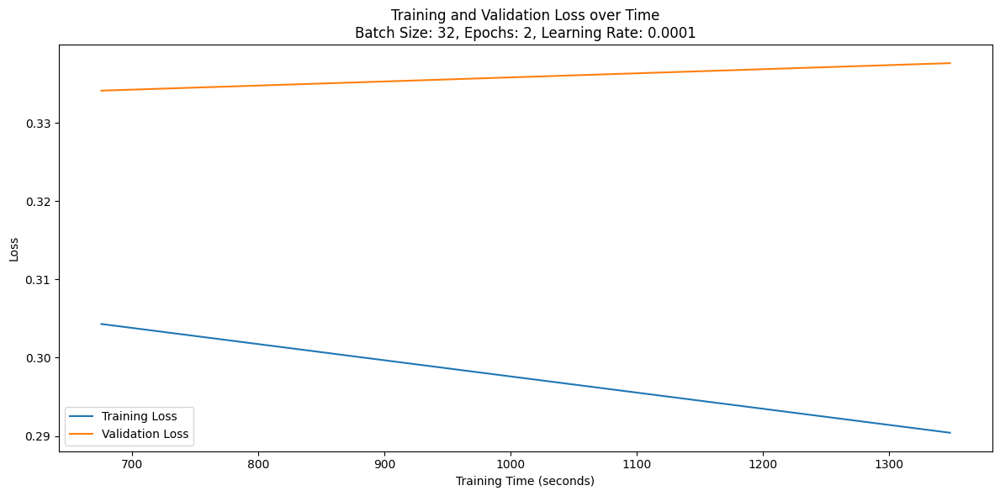

In [27]:
main_model = fine_tune_model(main_model, train_dataset, validation_dataset, num_epochs, batch_size, learning_rate)

In [28]:
# Save the model
torch.save(main_model, 'main_model.pth')

In [29]:
def evaluate_model(model, test_dataset, batch_size): # Evaluate the model
    model.to(device) # Move model to device
    model.eval() # Set model to evaluation mode
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False) # Create test data loader
    all_predictions = [] # List to store all predictions
    all_labels = [] # List to store all labels
    all_probabilities = [] # List to store all probabilities

    with torch.no_grad(): # No need to calculate gradients
        for images, labels, _, _ in test_loader: # Loop through test set
            images = images.to(device) # Move images to device
            labels = labels.to(device) # Move labels to device
            outputs = model(images) # Forward pass
            probabilities = torch.sigmoid(outputs).squeeze() # Sigmoid to get probabilities
            predictions = (probabilities > 0.5).float() # Threshold at 0.5

            all_predictions.extend(predictions.cpu().numpy()) # Append to list
            all_labels.extend(labels.cpu().numpy()) # Append to list
            all_probabilities.extend(probabilities.cpu().numpy()) # Append to list

    all_predictions = np.array(all_predictions) # Convert to numpy array
    all_labels = np.array(all_labels) # Convert to numpy array
    all_probabilities = np.array(all_probabilities) # Convert to numpy array

    # Calculate metrics
    accuracy = accuracy_score(all_labels, all_predictions) # Calculate accuracy
    precision = precision_score(all_labels, all_predictions) # Calculate precision
    recall = recall_score(all_labels, all_predictions) # Calculate recall
    f1 = f1_score(all_labels, all_predictions) # Calculate F1 score
    fpr, tpr, _ = roc_curve(all_labels, all_probabilities) # Calculate ROC curve
    roc_auc = auc(fpr, tpr) # Calculate AUC
    cm = confusion_matrix(all_labels, all_predictions) # Calculate confusion matrix

    # Print metrics
    print(f"Accuracy: {accuracy:.4f}")
    print(f"Precision: {precision:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"F1 Score: {f1:.4f}")
    print(f"AUC: {roc_auc:.4f}")

    # Plot ROC curve
    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend(loc="lower right")
    plt.show()

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.title('Confusion Matrix')
    plt.show()

Accuracy: 0.8643
Precision: 0.7141
Recall: 0.7922
F1 Score: 0.7511
AUC: 0.9305


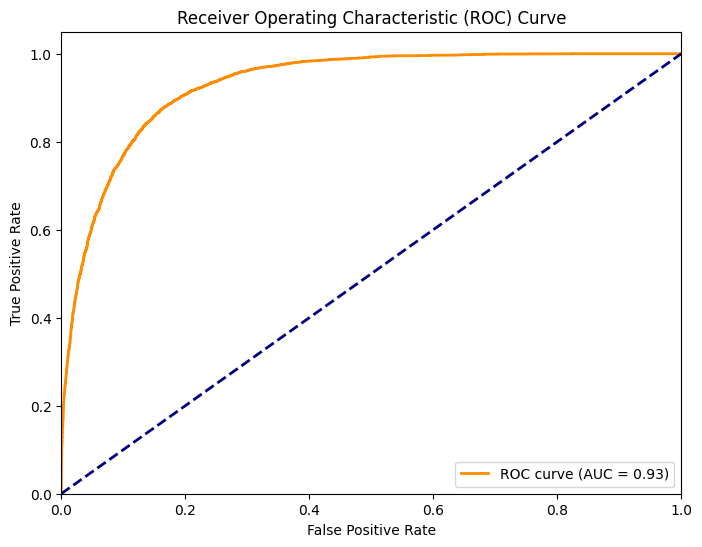

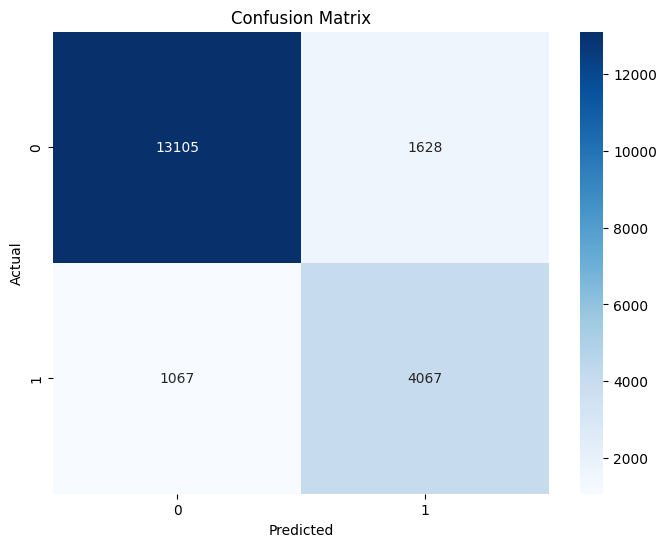

In [30]:
evaluate_model(main_model, test_dataset, batch_size)

In [31]:
model_summary = summary(main_model, verbose=True)
# This will print a detailed summary of your model
print(model_summary)

Layer (type:depth-idx)                   Param #
ResNet                                   --
├─Conv2d: 1-1                            9,408
├─BatchNorm2d: 1-2                       128
├─ReLU: 1-3                              --
├─MaxPool2d: 1-4                         --
├─Sequential: 1-5                        --
│    └─BasicBlock: 2-1                   --
│    │    └─Conv2d: 3-1                  36,864
│    │    └─BatchNorm2d: 3-2             128
│    │    └─ReLU: 3-3                    --
│    │    └─Conv2d: 3-4                  36,864
│    │    └─BatchNorm2d: 3-5             128
│    └─BasicBlock: 2-2                   --
│    │    └─Conv2d: 3-6                  36,864
│    │    └─BatchNorm2d: 3-7             128
│    │    └─ReLU: 3-8                    --
│    │    └─Conv2d: 3-9                  36,864
│    │    └─BatchNorm2d: 3-10            128
├─Sequential: 1-6                        --
│    └─BasicBlock: 2-3                   --
│    │    └─Conv2d: 3-11                 73,728

In [32]:
main_model

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

## Experiments

### Hyperparameter Tuning

In [33]:
os.environ['CUDA_LAUNCH_BLOCKING'] = '1' # Set CUDA_LAUNCH_BLOCKING=1

In [34]:
batch_size_list = [8, 32, 128] # batch size list
learning_rate_list = [0.001, 0.01, 0.1] # learning rate list
num_epochs_list = [1, 3] # number of epochs list

In [35]:
# Training on the whole dataset will take a lot of time and resources.
# Reduce the datset to 40% of the original size for faster training.

train_indices = list(range(0, 60000)) # Define the indices for the training set
test_indices = list(range(162770, 170094)) # Define the indices for the test set
validation_indices = list(range(182637, 189996)) # Define the indices for the validation set

# Create Subset datasets
train_dataset = Subset(dataset, train_indices) # Create the training set
test_dataset = Subset(dataset, test_indices) # Create the test set
validation_dataset = Subset(dataset, validation_indices) # Create the validation set

print(f"Training set size: {len(train_dataset)}") # Print the size of the training set
print(f"Test set size: {len(test_dataset)}") # Print the size of the test set
print(f"Validation set size: {len(validation_dataset)}") # Print the size of the validation set

Training set size: 60000
Test set size: 7324
Validation set size: 7359


In [36]:
def train_model_no_plot(model, train_dataset, val_dataset, num_epochs, batch_size, learning_rate):
   
    # Create data loaders
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
    
    # Replace the last fully connected layer
    num_ftrs = model.fc.in_features # Number of input features for the fully connected layer
    model.fc = nn.Linear(num_ftrs, 1)  # Binary classification
    
    # Move model to device
    model = model.to(device) # Move the model to the device
    
    # Define loss function and optimizer
    criterion = nn.BCEWithLogitsLoss() # Binary cross-entropy loss
    optimizer = optim.Adam(model.parameters(), lr=learning_rate) # Adam optimizer
    
    # Lists to store losses and times for plotting
    train_losses = []
    val_losses = []
    times = []
    start_time = time.time()
    
    # Training loop
    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0
        
        for images, labels, _, _ in tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs}"): #
            images = images.to(device) # Move images to device
            labels = labels.float().to(device) # Move labels to device
            optimizer.zero_grad() # Zero the gradients
            outputs = model(images) # Forward pass
            loss = criterion(outputs.squeeze(), labels) # Calculate loss
            loss.backward() # Backward pass
            optimizer.step() # Update weights
            running_loss += loss.item() * images.size(0) # Update running loss
        epoch_loss = running_loss / len(train_dataset) # Calculate epoch loss
        train_losses.append(epoch_loss) # Append to list
        
        # Validation
        model.eval()
        val_loss = 0.0
        correct = 0
        total = 0
        
        with torch.no_grad(): # No need to calculate gradients
            for images, labels, _, _ in val_loader: # Loop through validation set
                images = images.to(device) # Move images to device
                labels = labels.float().to(device) # Move labels to device
                outputs = model(images) # Forward pass
                loss = criterion(outputs.squeeze(), labels) # Calculate loss
                val_loss += loss.item() * images.size(0) # Update validation loss
                predicted = torch.round(torch.sigmoid(outputs.squeeze())) # Round the output to 0 or 1
                total += labels.size(0) # Update total
                correct += (predicted == labels).sum().item() # Update correct
        
        val_loss = val_loss / len(val_dataset) # Calculate validation loss
        val_losses.append(val_loss) # Append to list
        accuracy = correct / total # Calculate accuracy
        
        print(f"Epoch {epoch+1}/{num_epochs}")
        print(f"Train Loss: {epoch_loss:.4f}")
        print(f"Val Loss: {val_loss:.4f}")
        print(f"Val Accuracy: {accuracy:.4f}")
        print()

    return model

In [37]:
def fine_tune_model_no_plot(model, train_dataset, val_dataset, num_epochs, batch_size, learning_rate):
    model.to(device) # Move model to device

    # Fine-tune the last layer for a few epochs
    model = train_model_no_plot(model, train_dataset, validation_dataset, num_epochs, batch_size, learning_rate)

    # Unfreeze all layers and fine-tune the entire model for a few more epochs

    for param in model.parameters():
        param.requires_grad = True

    # Train the entire model for a few more epochs
    model = train_model_no_plot(model, train_dataset, validation_dataset, num_epochs, batch_size, learning_rate/10)

    return model

In [38]:
def evaluate_model_no_plot(model, test_dataset, batch_size): # Evaluate the model
    model.to(device) # Move model to device
    model.eval() # Set model to evaluation mode
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False) # Create test data loader
    all_predictions = [] # List to store all predictions
    all_labels = [] # List to store all labels
    all_probabilities = [] # List to store all probabilities

    with torch.no_grad(): # No need to calculate gradients
        for images, labels, _, _ in test_loader: # Loop through test set
            images = images.to(device) # Move images to device
            labels = labels.to(device) # Move labels to device
            outputs = model(images) # Forward pass
            probabilities = torch.sigmoid(outputs).squeeze() # Sigmoid to get probabilities
            predictions = (probabilities > 0.5).float() # Threshold at 0.5

            all_predictions.extend(predictions.cpu().numpy()) # Append to list
            all_labels.extend(labels.cpu().numpy()) # Append to list
            all_probabilities.extend(probabilities.cpu().numpy()) # Append to list

    all_predictions = np.array(all_predictions) # Convert to numpy array
    all_labels = np.array(all_labels) # Convert to numpy array
    all_probabilities = np.array(all_probabilities) # Convert to numpy array

    # Calculate metrics
    accuracy = accuracy_score(all_labels, all_predictions) # Calculate accuracy
    precision = precision_score(all_labels, all_predictions) # Calculate precision
    recall = recall_score(all_labels, all_predictions) # Calculate recall
    f1 = f1_score(all_labels, all_predictions) # Calculate F1 score
    fpr, tpr, _ = roc_curve(all_labels, all_probabilities) # Calculate ROC curve
    roc_auc = auc(fpr, tpr) # Calculate AUC
    cm = confusion_matrix(all_labels, all_predictions) # Calculate confusion matrix

    # Print metrics
    print(f"Accuracy: {accuracy:.4f}")
    print(f"Precision: {precision:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"F1 Score: {f1:.4f}")
    print(f"AUC: {roc_auc:.4f}")

In [39]:
for num_epoch in num_epochs_list: # Loop through the number of epochs
    for batch_size in batch_size_list: # Loop through the batch size
        for learning_rate in learning_rate_list: # Loop through the learning rate
            print(f"Training with Batch Size: {batch_size}, Learning Rate: {learning_rate}, Epochs: {num_epoch}") # Print the hyperparameters
            test_model = models.resnet18(pretrained=True) # Load the pre-trained ResNet-18 model
            test_model = fine_tune_model_no_plot(test_model, train_dataset, validation_dataset, num_epoch, batch_size, learning_rate) # Fine-tune the model
            evaluate_model_no_plot(test_model, test_dataset, batch_size) # Evaluate the model
            torch.cuda.empty_cache()
            print("*"*100)

Training with Batch Size: 8, Learning Rate: 0.001, Epochs: 1


Epoch 1/1: 100%|██████████| 7500/7500 [05:09<00:00, 24.27it/s]


Epoch 1/1
Train Loss: 0.4035
Val Loss: 0.4929
Val Accuracy: 0.7614



Epoch 1/1: 100%|██████████| 7500/7500 [05:09<00:00, 24.20it/s]


Epoch 1/1
Train Loss: 0.3352
Val Loss: 0.3572
Val Accuracy: 0.8278

Accuracy: 0.8543
Precision: 0.6918
Recall: 0.7756
F1 Score: 0.7313
AUC: 0.9215
****************************************************************************************************
Training with Batch Size: 8, Learning Rate: 0.01, Epochs: 1


Epoch 1/1: 100%|██████████| 7500/7500 [05:09<00:00, 24.24it/s]


Epoch 1/1
Train Loss: 0.5305
Val Loss: 0.4533
Val Accuracy: 0.7854



Epoch 1/1: 100%|██████████| 7500/7500 [05:07<00:00, 24.38it/s]


Epoch 1/1
Train Loss: 0.4054
Val Loss: 0.4098
Val Accuracy: 0.8001

Accuracy: 0.8229
Precision: 0.6678
Recall: 0.6111
F1 Score: 0.6382
AUC: 0.8822
****************************************************************************************************
Training with Batch Size: 8, Learning Rate: 0.1, Epochs: 1


Epoch 1/1: 100%|██████████| 7500/7500 [05:07<00:00, 24.42it/s]


Epoch 1/1
Train Loss: 0.5966
Val Loss: 0.5990
Val Accuracy: 0.7165



Epoch 1/1: 100%|██████████| 7500/7500 [05:07<00:00, 24.43it/s]


Epoch 1/1
Train Loss: 0.5431
Val Loss: 0.5120
Val Accuracy: 0.7316

Accuracy: 0.7586
Precision: 0.5630
Recall: 0.2484
F1 Score: 0.3447
AUC: 0.7713
****************************************************************************************************
Training with Batch Size: 32, Learning Rate: 0.001, Epochs: 1


Epoch 1/1: 100%|██████████| 1875/1875 [03:53<00:00,  8.04it/s]


Epoch 1/1
Train Loss: 0.3636
Val Loss: 0.3773
Val Accuracy: 0.8204



Epoch 1/1: 100%|██████████| 1875/1875 [03:54<00:00,  7.99it/s]


Epoch 1/1
Train Loss: 0.3190
Val Loss: 0.3423
Val Accuracy: 0.8367

Accuracy: 0.8603
Precision: 0.7487
Recall: 0.6827
F1 Score: 0.7142
AUC: 0.9268
****************************************************************************************************
Training with Batch Size: 32, Learning Rate: 0.01, Epochs: 1


Epoch 1/1: 100%|██████████| 1875/1875 [03:51<00:00,  8.09it/s]


Epoch 1/1
Train Loss: 0.5821
Val Loss: 0.5785
Val Accuracy: 0.7138



Epoch 1/1: 100%|██████████| 1875/1875 [03:52<00:00,  8.06it/s]


Epoch 1/1
Train Loss: 0.4645
Val Loss: 0.4165
Val Accuracy: 0.7910

Accuracy: 0.8136
Precision: 0.6327
Recall: 0.6458
F1 Score: 0.6392
AUC: 0.8731
****************************************************************************************************
Training with Batch Size: 32, Learning Rate: 0.1, Epochs: 1


Epoch 1/1: 100%|██████████| 1875/1875 [03:52<00:00,  8.07it/s]


Epoch 1/1
Train Loss: 0.6218
Val Loss: 0.5976
Val Accuracy: 0.7165



Epoch 1/1: 100%|██████████| 1875/1875 [03:51<00:00,  8.11it/s]


Epoch 1/1
Train Loss: 0.4749
Val Loss: 0.4518
Val Accuracy: 0.7735

Accuracy: 0.8013
Precision: 0.5869
Recall: 0.7521
F1 Score: 0.6593
AUC: 0.8706
****************************************************************************************************
Training with Batch Size: 128, Learning Rate: 0.001, Epochs: 1


Epoch 1/1: 100%|██████████| 469/469 [03:44<00:00,  2.09it/s]


Epoch 1/1
Train Loss: 0.3467
Val Loss: 0.3501
Val Accuracy: 0.8293



Epoch 1/1: 100%|██████████| 469/469 [03:47<00:00,  2.06it/s]


Epoch 1/1
Train Loss: 0.3070
Val Loss: 0.3372
Val Accuracy: 0.8401

Accuracy: 0.8659
Precision: 0.7506
Recall: 0.7121
F1 Score: 0.7308
AUC: 0.9289
****************************************************************************************************
Training with Batch Size: 128, Learning Rate: 0.01, Epochs: 1


Epoch 1/1: 100%|██████████| 469/469 [03:45<00:00,  2.08it/s]


Epoch 1/1
Train Loss: 0.5655
Val Loss: 0.6707
Val Accuracy: 0.5535



Epoch 1/1: 100%|██████████| 469/469 [03:46<00:00,  2.07it/s]


Epoch 1/1
Train Loss: 0.4092
Val Loss: 0.4009
Val Accuracy: 0.8064

Accuracy: 0.8334
Precision: 0.7359
Recall: 0.5433
F1 Score: 0.6251
AUC: 0.8913
****************************************************************************************************
Training with Batch Size: 128, Learning Rate: 0.1, Epochs: 1


Epoch 1/1: 100%|██████████| 469/469 [03:45<00:00,  2.08it/s]


Epoch 1/1
Train Loss: 0.6291
Val Loss: 0.6300
Val Accuracy: 0.7165



Epoch 1/1: 100%|██████████| 469/469 [03:46<00:00,  2.07it/s]


Epoch 1/1
Train Loss: 0.5024
Val Loss: 0.4739
Val Accuracy: 0.7607

Accuracy: 0.7856
Precision: 0.6144
Recall: 0.4332
F1 Score: 0.5081
AUC: 0.8258
****************************************************************************************************
Training with Batch Size: 8, Learning Rate: 0.001, Epochs: 3


Epoch 1/3: 100%|██████████| 7500/7500 [05:08<00:00, 24.35it/s]


Epoch 1/3
Train Loss: 0.4052
Val Loss: 0.3784
Val Accuracy: 0.8221



Epoch 2/3: 100%|██████████| 7500/7500 [05:08<00:00, 24.35it/s]


Epoch 2/3
Train Loss: 0.3577
Val Loss: 0.4015
Val Accuracy: 0.8089



Epoch 3/3: 100%|██████████| 7500/7500 [05:07<00:00, 24.40it/s]


Epoch 3/3
Train Loss: 0.3391
Val Loss: 0.3815
Val Accuracy: 0.8151



Epoch 1/3: 100%|██████████| 7500/7500 [05:06<00:00, 24.44it/s]


Epoch 1/3
Train Loss: 0.3225
Val Loss: 0.3588
Val Accuracy: 0.8320



Epoch 2/3: 100%|██████████| 7500/7500 [05:08<00:00, 24.31it/s]


Epoch 2/3
Train Loss: 0.2993
Val Loss: 0.3522
Val Accuracy: 0.8318



Epoch 3/3: 100%|██████████| 7500/7500 [05:07<00:00, 24.39it/s]


Epoch 3/3
Train Loss: 0.2912
Val Loss: 0.3548
Val Accuracy: 0.8319

Accuracy: 0.8598
Precision: 0.7128
Recall: 0.7559
F1 Score: 0.7337
AUC: 0.9217
****************************************************************************************************
Training with Batch Size: 8, Learning Rate: 0.01, Epochs: 3


Epoch 1/3: 100%|██████████| 7500/7500 [05:08<00:00, 24.31it/s]


Epoch 1/3
Train Loss: 0.5533
Val Loss: 0.5204
Val Accuracy: 0.7278



Epoch 2/3: 100%|██████████| 7500/7500 [05:06<00:00, 24.47it/s]


Epoch 2/3
Train Loss: 0.4166
Val Loss: 0.4061
Val Accuracy: 0.8074



Epoch 3/3: 100%|██████████| 7500/7500 [05:06<00:00, 24.47it/s]


Epoch 3/3
Train Loss: 0.3653
Val Loss: 0.3899
Val Accuracy: 0.8198



Epoch 1/3: 100%|██████████| 7500/7500 [05:06<00:00, 24.48it/s]


Epoch 1/3
Train Loss: 0.3434
Val Loss: 0.3642
Val Accuracy: 0.8261



Epoch 2/3: 100%|██████████| 7500/7500 [05:07<00:00, 24.43it/s]


Epoch 2/3
Train Loss: 0.3249
Val Loss: 0.3638
Val Accuracy: 0.8288



Epoch 3/3: 100%|██████████| 7500/7500 [05:07<00:00, 24.40it/s]


Epoch 3/3
Train Loss: 0.3204
Val Loss: 0.3626
Val Accuracy: 0.8276

Accuracy: 0.8524
Precision: 0.7096
Recall: 0.7153
F1 Score: 0.7124
AUC: 0.9158
****************************************************************************************************
Training with Batch Size: 8, Learning Rate: 0.1, Epochs: 3


Epoch 1/3: 100%|██████████| 7500/7500 [05:07<00:00, 24.40it/s]


Epoch 1/3
Train Loss: 0.5990
Val Loss: 0.5979
Val Accuracy: 0.7165



Epoch 2/3: 100%|██████████| 7500/7500 [05:04<00:00, 24.60it/s]


Epoch 2/3
Train Loss: 0.5838
Val Loss: 0.6003
Val Accuracy: 0.7165



Epoch 3/3: 100%|██████████| 7500/7500 [05:05<00:00, 24.55it/s]


Epoch 3/3
Train Loss: 0.5817
Val Loss: 0.5995
Val Accuracy: 0.7165



Epoch 1/3: 100%|██████████| 7500/7500 [05:06<00:00, 24.44it/s]


Epoch 1/3
Train Loss: 0.5790
Val Loss: 0.5966
Val Accuracy: 0.7165



Epoch 2/3: 100%|██████████| 7500/7500 [05:05<00:00, 24.52it/s]


Epoch 2/3
Train Loss: 0.5782
Val Loss: 0.5967
Val Accuracy: 0.7165



Epoch 3/3: 100%|██████████| 7500/7500 [05:05<00:00, 24.58it/s]


Epoch 3/3
Train Loss: 0.5784
Val Loss: 0.5963
Val Accuracy: 0.7165

Accuracy: 0.7444
Precision: 0.0000
Recall: 0.0000
F1 Score: 0.0000
AUC: 0.5000
****************************************************************************************************
Training with Batch Size: 32, Learning Rate: 0.001, Epochs: 3


Epoch 1/3: 100%|██████████| 1875/1875 [03:55<00:00,  7.98it/s]


Epoch 1/3
Train Loss: 0.3652
Val Loss: 0.3842
Val Accuracy: 0.8187



Epoch 2/3: 100%|██████████| 1875/1875 [03:55<00:00,  7.98it/s]


Epoch 2/3
Train Loss: 0.3402
Val Loss: 0.3648
Val Accuracy: 0.8276



Epoch 3/3: 100%|██████████| 1875/1875 [03:54<00:00,  8.00it/s]


Epoch 3/3
Train Loss: 0.3295
Val Loss: 0.3537
Val Accuracy: 0.8323



Epoch 1/3: 100%|██████████| 1875/1875 [03:54<00:00,  7.99it/s]


Epoch 1/3
Train Loss: 0.2951
Val Loss: 0.3440
Val Accuracy: 0.8365



Epoch 2/3: 100%|██████████| 1875/1875 [03:53<00:00,  8.03it/s]


Epoch 2/3
Train Loss: 0.2723
Val Loss: 0.3631
Val Accuracy: 0.8335



Epoch 3/3: 100%|██████████| 1875/1875 [03:54<00:00,  7.98it/s]


Epoch 3/3
Train Loss: 0.2530
Val Loss: 0.3606
Val Accuracy: 0.8349

Accuracy: 0.8613
Precision: 0.7166
Recall: 0.7564
F1 Score: 0.7360
AUC: 0.9231
****************************************************************************************************
Training with Batch Size: 32, Learning Rate: 0.01, Epochs: 3


Epoch 1/3: 100%|██████████| 1875/1875 [03:55<00:00,  7.95it/s]


Epoch 1/3
Train Loss: 0.5733
Val Loss: 0.5321
Val Accuracy: 0.7312



Epoch 2/3: 100%|██████████| 1875/1875 [03:54<00:00,  8.01it/s]


Epoch 2/3
Train Loss: 0.4312
Val Loss: 0.4346
Val Accuracy: 0.7860



Epoch 3/3: 100%|██████████| 1875/1875 [03:54<00:00,  8.00it/s]


Epoch 3/3
Train Loss: 0.3722
Val Loss: 0.4045
Val Accuracy: 0.8085



Epoch 1/3: 100%|██████████| 1875/1875 [03:55<00:00,  7.98it/s]


Epoch 1/3
Train Loss: 0.3442
Val Loss: 0.3593
Val Accuracy: 0.8300



Epoch 2/3: 100%|██████████| 1875/1875 [03:54<00:00,  7.98it/s]


Epoch 2/3
Train Loss: 0.3235
Val Loss: 0.3643
Val Accuracy: 0.8339



Epoch 3/3: 100%|██████████| 1875/1875 [03:56<00:00,  7.92it/s]


Epoch 3/3
Train Loss: 0.3152
Val Loss: 0.3699
Val Accuracy: 0.8250

Accuracy: 0.8486
Precision: 0.7849
Recall: 0.5614
F1 Score: 0.6546
AUC: 0.9193
****************************************************************************************************
Training with Batch Size: 32, Learning Rate: 0.1, Epochs: 3


Epoch 1/3: 100%|██████████| 1875/1875 [03:55<00:00,  7.96it/s]


Epoch 1/3
Train Loss: 0.5344
Val Loss: 0.4712
Val Accuracy: 0.7580



Epoch 2/3: 100%|██████████| 1875/1875 [03:54<00:00,  7.98it/s]


Epoch 2/3
Train Loss: 0.4131
Val Loss: 0.4125
Val Accuracy: 0.8024



Epoch 3/3: 100%|██████████| 1875/1875 [03:55<00:00,  7.98it/s]


Epoch 3/3
Train Loss: 0.3850
Val Loss: 0.3830
Val Accuracy: 0.8201



Epoch 1/3: 100%|██████████| 1875/1875 [03:53<00:00,  8.02it/s]


Epoch 1/3
Train Loss: 0.3484
Val Loss: 0.3686
Val Accuracy: 0.8210



Epoch 2/3: 100%|██████████| 1875/1875 [03:54<00:00,  7.99it/s]


Epoch 2/3
Train Loss: 0.3292
Val Loss: 0.3614
Val Accuracy: 0.8248



Epoch 3/3: 100%|██████████| 1875/1875 [03:54<00:00,  8.01it/s]


Epoch 3/3
Train Loss: 0.3214
Val Loss: 0.3662
Val Accuracy: 0.8229

Accuracy: 0.8510
Precision: 0.6857
Recall: 0.7703
F1 Score: 0.7255
AUC: 0.9175
****************************************************************************************************
Training with Batch Size: 128, Learning Rate: 0.001, Epochs: 3


Epoch 1/3: 100%|██████████| 469/469 [03:46<00:00,  2.07it/s]


Epoch 1/3
Train Loss: 0.3495
Val Loss: 0.3562
Val Accuracy: 0.8304



Epoch 2/3: 100%|██████████| 469/469 [03:48<00:00,  2.05it/s]


Epoch 2/3
Train Loss: 0.3190
Val Loss: 0.3519
Val Accuracy: 0.8327



Epoch 3/3: 100%|██████████| 469/469 [03:47<00:00,  2.06it/s]


Epoch 3/3
Train Loss: 0.3057
Val Loss: 0.3658
Val Accuracy: 0.8285



Epoch 1/3: 100%|██████████| 469/469 [03:46<00:00,  2.07it/s]


Epoch 1/3
Train Loss: 0.2735
Val Loss: 0.3594
Val Accuracy: 0.8401



Epoch 2/3: 100%|██████████| 469/469 [03:45<00:00,  2.08it/s]


Epoch 2/3
Train Loss: 0.2238
Val Loss: 0.3828
Val Accuracy: 0.8323



Epoch 3/3: 100%|██████████| 469/469 [03:43<00:00,  2.10it/s]


Epoch 3/3
Train Loss: 0.1830
Val Loss: 0.4498
Val Accuracy: 0.8251

Accuracy: 0.8484
Precision: 0.7718
Recall: 0.5780
F1 Score: 0.6610
AUC: 0.9149
****************************************************************************************************
Training with Batch Size: 128, Learning Rate: 0.01, Epochs: 3


Epoch 1/3: 100%|██████████| 469/469 [03:47<00:00,  2.07it/s]


Epoch 1/3
Train Loss: 0.5678
Val Loss: 0.5429
Val Accuracy: 0.7195



Epoch 2/3: 100%|██████████| 469/469 [03:49<00:00,  2.05it/s]


Epoch 2/3
Train Loss: 0.4548
Val Loss: 0.4745
Val Accuracy: 0.7487



Epoch 3/3: 100%|██████████| 469/469 [03:45<00:00,  2.08it/s]


Epoch 3/3
Train Loss: 0.3746
Val Loss: 0.3994
Val Accuracy: 0.8163



Epoch 1/3: 100%|██████████| 469/469 [03:47<00:00,  2.06it/s]


Epoch 1/3
Train Loss: 0.3370
Val Loss: 0.3638
Val Accuracy: 0.8274



Epoch 2/3: 100%|██████████| 469/469 [03:46<00:00,  2.07it/s]


Epoch 2/3
Train Loss: 0.3201
Val Loss: 0.3538
Val Accuracy: 0.8327



Epoch 3/3: 100%|██████████| 469/469 [03:44<00:00,  2.09it/s]


Epoch 3/3
Train Loss: 0.3122
Val Loss: 0.3596
Val Accuracy: 0.8288

Accuracy: 0.8484
Precision: 0.6724
Recall: 0.7938
F1 Score: 0.7281
AUC: 0.9197
****************************************************************************************************
Training with Batch Size: 128, Learning Rate: 0.1, Epochs: 3


Epoch 1/3: 100%|██████████| 469/469 [03:45<00:00,  2.08it/s]


Epoch 1/3
Train Loss: 0.6273
Val Loss: 0.5350
Val Accuracy: 0.7252



Epoch 2/3: 100%|██████████| 469/469 [03:44<00:00,  2.09it/s]


Epoch 2/3
Train Loss: 0.4557
Val Loss: 0.4875
Val Accuracy: 0.7690



Epoch 3/3: 100%|██████████| 469/469 [03:46<00:00,  2.07it/s]


Epoch 3/3
Train Loss: 0.4058
Val Loss: 0.4472
Val Accuracy: 0.7917



Epoch 1/3: 100%|██████████| 469/469 [03:45<00:00,  2.08it/s]


Epoch 1/3
Train Loss: 0.3865
Val Loss: 0.3992
Val Accuracy: 0.8040



Epoch 2/3: 100%|██████████| 469/469 [03:43<00:00,  2.10it/s]


Epoch 2/3
Train Loss: 0.3590
Val Loss: 0.3813
Val Accuracy: 0.8247



Epoch 3/3: 100%|██████████| 469/469 [03:47<00:00,  2.06it/s]


Epoch 3/3
Train Loss: 0.3419
Val Loss: 0.3641
Val Accuracy: 0.8269

Accuracy: 0.8463
Precision: 0.7186
Recall: 0.6549
F1 Score: 0.6853
AUC: 0.9103
****************************************************************************************************


In [40]:
torch.cuda.empty_cache() # Clear the cache

### Loading ResNet18 with different frozen layers

In [47]:
batch_size = 32 # batch size
learning_rate = 0.001 # learning rate
num_epochs = 2 # number of epochs

In [48]:
train_indices = list(range(0, 162770)) # Define the indices for the training set
test_indices = list(range(162770, 182637)) # Define the indices for the test set
validation_indices = list(range(182637, 202599)) # Define the indices for the validation set
# Create Subset datasets
train_dataset = Subset(dataset, train_indices) # Create the training set
test_dataset = Subset(dataset, test_indices) # Create the test set
validation_dataset = Subset(dataset, validation_indices) # Create the validation set

In [49]:
def load_resnet18_with_frozen_layers(num_frozen_layers): # Load ResNet-18 with frozen layers
    # Load pretrained ResNet-18
    model = resnet18(weights=ResNet18_Weights.DEFAULT) # Load the pre-trained ResNet-18 model
    layers = list(model.children()) # Get a list of all layers
    
    # Freeze the specified number of layers
    for layer in layers[:num_frozen_layers]: # Loop through the layers
        for param in layer.parameters(): # Loop through the parameters
            param.requires_grad = False # Freeze the layer    
    print(f"ResNet-18 loaded with {num_frozen_layers} layers frozen.") # Print message
    total_params = sum(p.numel() for p in model.parameters()) # Calculate total parameters
    learnable_params = sum(p.numel() for p in model.parameters() if p.requires_grad) # Calculate learnable parameters
    print(f"Total Parameters: {total_params}") # Print total parameters
    print(f"Learnable Parameters: {learnable_params}") # Print learnable parameters
    return model # Return the model

def print_layer_status(model): # Print the status of each layer
    for name, param in model.named_parameters(): # Loop through the layers
        print(f"{name}: {'Frozen' if not param.requires_grad else 'Trainable'}") # Print the status of each layer

In [50]:
model_exp_1 = load_resnet18_with_frozen_layers(1) # Load ResNet-18 with 1 layer frozen
model_exp_2 = load_resnet18_with_frozen_layers(3) # Load ResNet-18 with 3 layers frozen
model_exp_3 = load_resnet18_with_frozen_layers(5) # Load ResNet-18 with 5 layers frozen
model_exp_4 = load_resnet18_with_frozen_layers(7) # Load ResNet-18 with 7 layers frozen
model_exp_5 = load_resnet18_with_frozen_layers(9) # Load ResNet-18 with 9 layers frozen
exp_models = [model_exp_1, model_exp_2, model_exp_3, model_exp_4, model_exp_5] # List of experimental models

for model in exp_models: # Loop through the experimental models
    print_layer_status(model) # Print the status of each layer

ResNet-18 loaded with 1 layers frozen.
Total Parameters: 11689512
Learnable Parameters: 11680104
ResNet-18 loaded with 3 layers frozen.
Total Parameters: 11689512
Learnable Parameters: 11679976
ResNet-18 loaded with 5 layers frozen.
Total Parameters: 11689512
Learnable Parameters: 11532008
ResNet-18 loaded with 7 layers frozen.
Total Parameters: 11689512
Learnable Parameters: 8906728
ResNet-18 loaded with 9 layers frozen.
Total Parameters: 11689512
Learnable Parameters: 513000
conv1.weight: Frozen
bn1.weight: Trainable
bn1.bias: Trainable
layer1.0.conv1.weight: Trainable
layer1.0.bn1.weight: Trainable
layer1.0.bn1.bias: Trainable
layer1.0.conv2.weight: Trainable
layer1.0.bn2.weight: Trainable
layer1.0.bn2.bias: Trainable
layer1.1.conv1.weight: Trainable
layer1.1.bn1.weight: Trainable
layer1.1.bn1.bias: Trainable
layer1.1.conv2.weight: Trainable
layer1.1.bn2.weight: Trainable
layer1.1.bn2.bias: Trainable
layer2.0.conv1.weight: Trainable
layer2.0.bn1.weight: Trainable
layer2.0.bn1.bias: 

In [51]:
for exp_model in exp_models: # Loop through the experimental models
    print(summary(exp_model, input = [1, 3, 224, 224])) # Print the summary of each model

Layer (type:depth-idx)                   Param #
ResNet                                   --
├─Conv2d: 1-1                            (9,408)
├─BatchNorm2d: 1-2                       128
├─ReLU: 1-3                              --
├─MaxPool2d: 1-4                         --
├─Sequential: 1-5                        --
│    └─BasicBlock: 2-1                   --
│    │    └─Conv2d: 3-1                  36,864
│    │    └─BatchNorm2d: 3-2             128
│    │    └─ReLU: 3-3                    --
│    │    └─Conv2d: 3-4                  36,864
│    │    └─BatchNorm2d: 3-5             128
│    └─BasicBlock: 2-2                   --
│    │    └─Conv2d: 3-6                  36,864
│    │    └─BatchNorm2d: 3-7             128
│    │    └─ReLU: 3-8                    --
│    │    └─Conv2d: 3-9                  36,864
│    │    └─BatchNorm2d: 3-10            128
├─Sequential: 1-6                        --
│    └─BasicBlock: 2-3                   --
│    │    └─Conv2d: 3-11                 73,7

****************************************************************************************************
model_exp_1


Epoch 1/2: 100%|██████████| 5087/5087 [10:18<00:00,  8.22it/s]


Epoch 1/2
Train Loss: 0.3494
Val Loss: 0.3585
Val Accuracy: 0.8222



Epoch 2/2: 100%|██████████| 5087/5087 [10:16<00:00,  8.26it/s]


Epoch 2/2
Train Loss: 0.3269
Val Loss: 0.3374
Val Accuracy: 0.8363



Epoch 1/2: 100%|██████████| 5087/5087 [10:34<00:00,  8.01it/s]


Epoch 1/2
Train Loss: 0.3032
Val Loss: 0.3313
Val Accuracy: 0.8416



Epoch 2/2: 100%|██████████| 5087/5087 [10:36<00:00,  7.99it/s]


Epoch 2/2
Train Loss: 0.2870
Val Loss: 0.3300
Val Accuracy: 0.8425

Accuracy: 0.8686
Precision: 0.7533
Recall: 0.7308
F1 Score: 0.7419
AUC: 0.9314


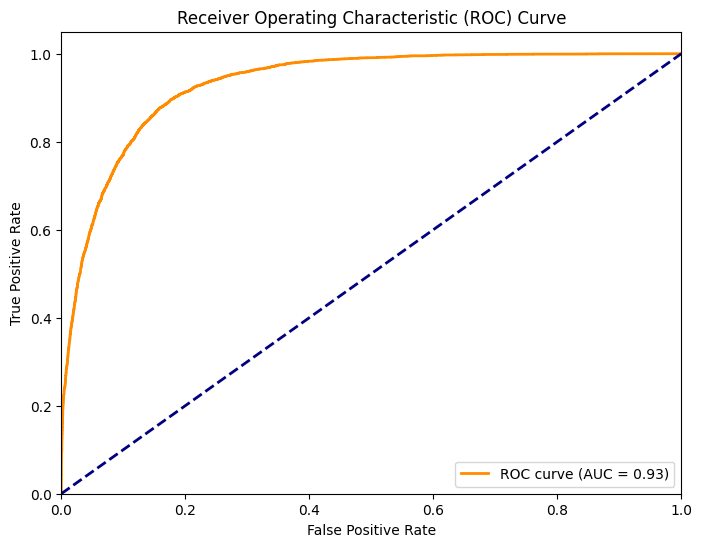

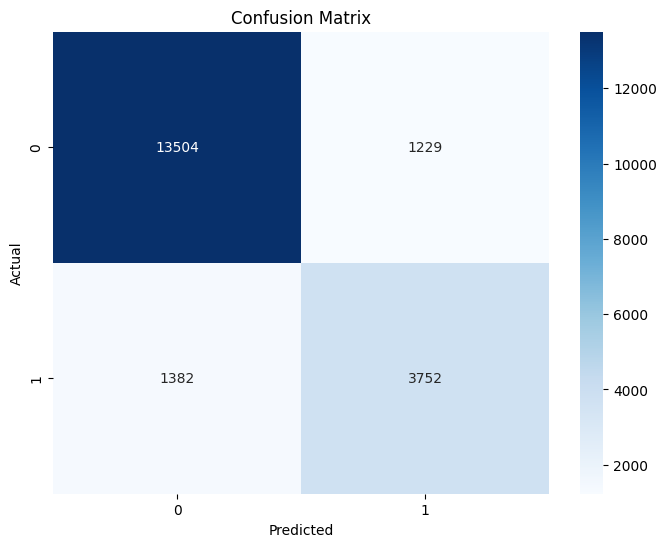

****************************************************************************************************
****************************************************************************************************
model_exp_2


Epoch 1/2: 100%|██████████| 5087/5087 [09:36<00:00,  8.82it/s]


Epoch 1/2
Train Loss: 0.3500
Val Loss: 0.3505
Val Accuracy: 0.8323



Epoch 2/2: 100%|██████████| 5087/5087 [09:39<00:00,  8.78it/s]


Epoch 2/2
Train Loss: 0.3287
Val Loss: 0.3462
Val Accuracy: 0.8313



Epoch 1/2: 100%|██████████| 5087/5087 [10:35<00:00,  8.01it/s]


Epoch 1/2
Train Loss: 0.3080
Val Loss: 0.3329
Val Accuracy: 0.8399



Epoch 2/2: 100%|██████████| 5087/5087 [10:34<00:00,  8.02it/s]


Epoch 2/2
Train Loss: 0.2872
Val Loss: 0.3302
Val Accuracy: 0.8425

Accuracy: 0.8684
Precision: 0.7597
Recall: 0.7176
F1 Score: 0.7381
AUC: 0.9313


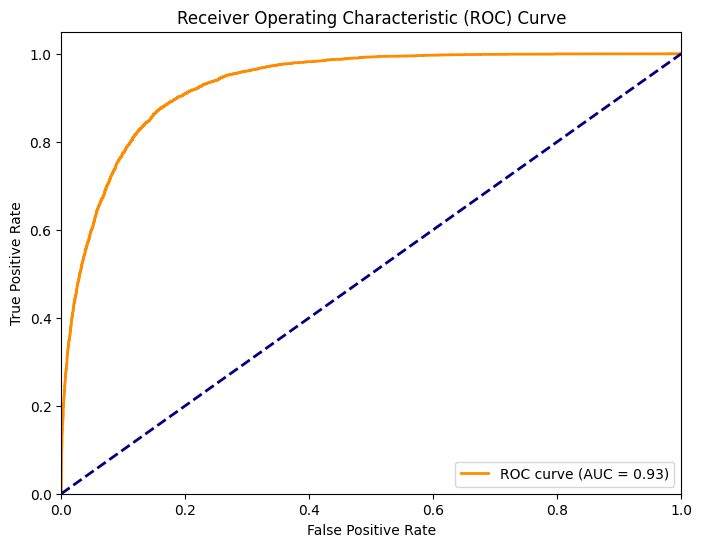

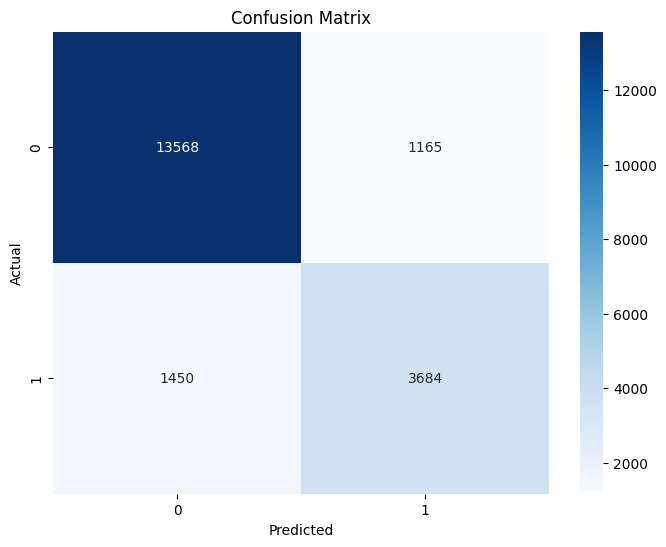

****************************************************************************************************
****************************************************************************************************
model_exp_3


Epoch 1/2: 100%|██████████| 5087/5087 [07:59<00:00, 10.61it/s]


Epoch 1/2
Train Loss: 0.3447
Val Loss: 0.3509
Val Accuracy: 0.8344



Epoch 2/2: 100%|██████████| 5087/5087 [08:03<00:00, 10.52it/s]


Epoch 2/2
Train Loss: 0.3192
Val Loss: 0.3578
Val Accuracy: 0.8240



Epoch 1/2: 100%|██████████| 5087/5087 [10:31<00:00,  8.06it/s]


Epoch 1/2
Train Loss: 0.2942
Val Loss: 0.3309
Val Accuracy: 0.8445



Epoch 2/2: 100%|██████████| 5087/5087 [10:33<00:00,  8.03it/s]


Epoch 2/2
Train Loss: 0.2705
Val Loss: 0.3478
Val Accuracy: 0.8333

Accuracy: 0.8589
Precision: 0.6937
Recall: 0.8130
F1 Score: 0.7486
AUC: 0.9287


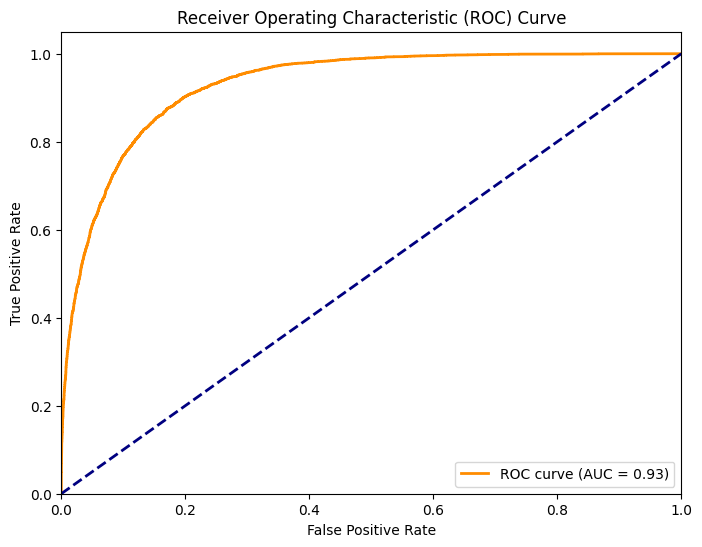

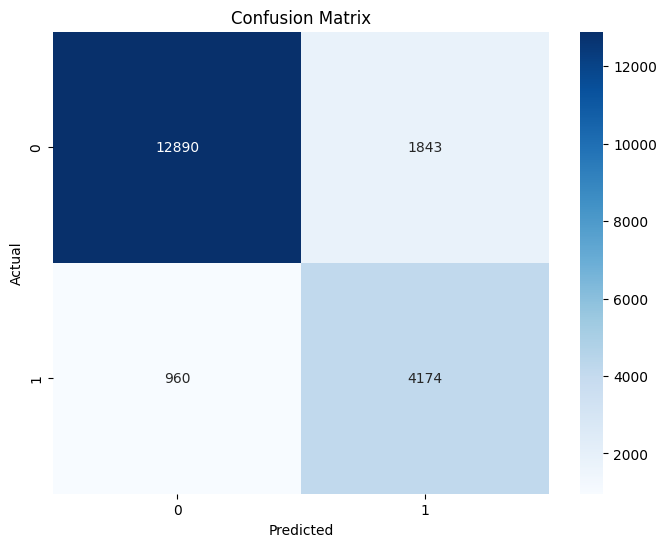

****************************************************************************************************
****************************************************************************************************
model_exp_4


Epoch 1/2: 100%|██████████| 5087/5087 [05:57<00:00, 14.21it/s]


Epoch 1/2
Train Loss: 0.3609
Val Loss: 0.3540
Val Accuracy: 0.8241



Epoch 2/2: 100%|██████████| 5087/5087 [05:59<00:00, 14.15it/s]


Epoch 2/2
Train Loss: 0.3315
Val Loss: 0.3547
Val Accuracy: 0.8268



Epoch 1/2: 100%|██████████| 5087/5087 [10:32<00:00,  8.04it/s]


Epoch 1/2
Train Loss: 0.3174
Val Loss: 0.3487
Val Accuracy: 0.8290



Epoch 2/2: 100%|██████████| 5087/5087 [10:36<00:00,  7.99it/s]


Epoch 2/2
Train Loss: 0.2736
Val Loss: 0.3338
Val Accuracy: 0.8419

Accuracy: 0.8670
Precision: 0.7529
Recall: 0.7222
F1 Score: 0.7373
AUC: 0.9300


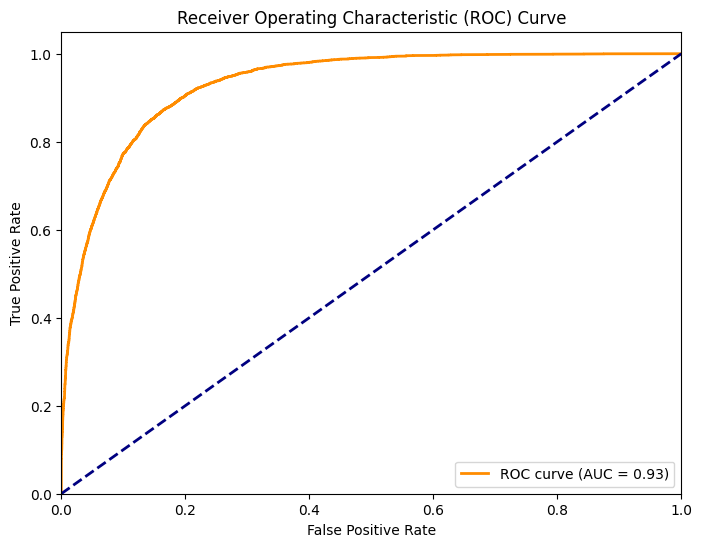

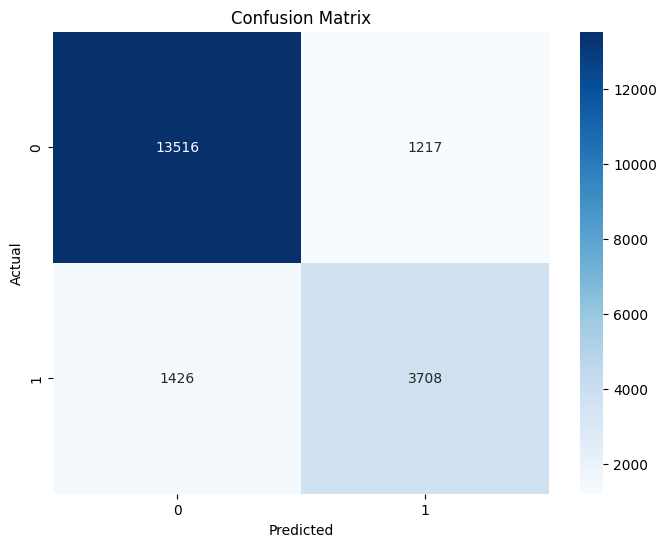

****************************************************************************************************
****************************************************************************************************
model_exp_5


Epoch 1/2: 100%|██████████| 5087/5087 [05:01<00:00, 16.85it/s]


Epoch 1/2
Train Loss: 0.4498
Val Loss: 0.4548
Val Accuracy: 0.7679



Epoch 2/2: 100%|██████████| 5087/5087 [05:03<00:00, 16.76it/s]


Epoch 2/2
Train Loss: 0.4418
Val Loss: 0.4489
Val Accuracy: 0.7717



Epoch 1/2: 100%|██████████| 5087/5087 [10:29<00:00,  8.08it/s]


Epoch 1/2
Train Loss: 0.3299
Val Loss: 0.3493
Val Accuracy: 0.8287



Epoch 2/2: 100%|██████████| 5087/5087 [10:32<00:00,  8.04it/s]


Epoch 2/2
Train Loss: 0.2985
Val Loss: 0.3256
Val Accuracy: 0.8443

Accuracy: 0.8664
Precision: 0.7627
Recall: 0.7010
F1 Score: 0.7305
AUC: 0.9288


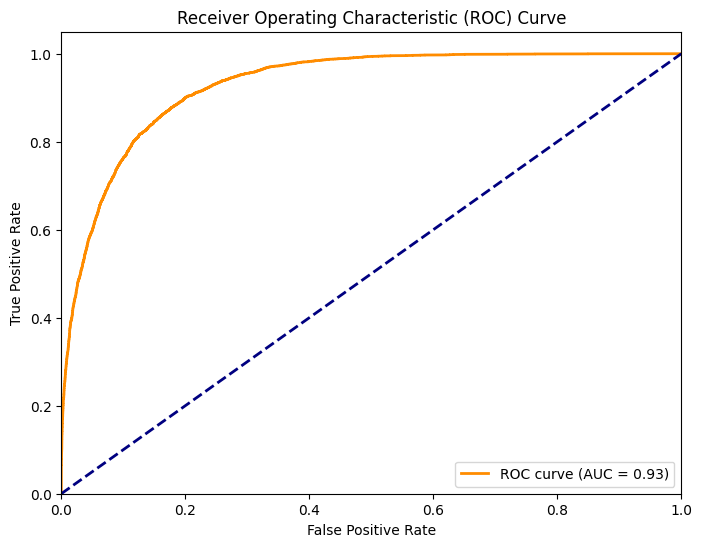

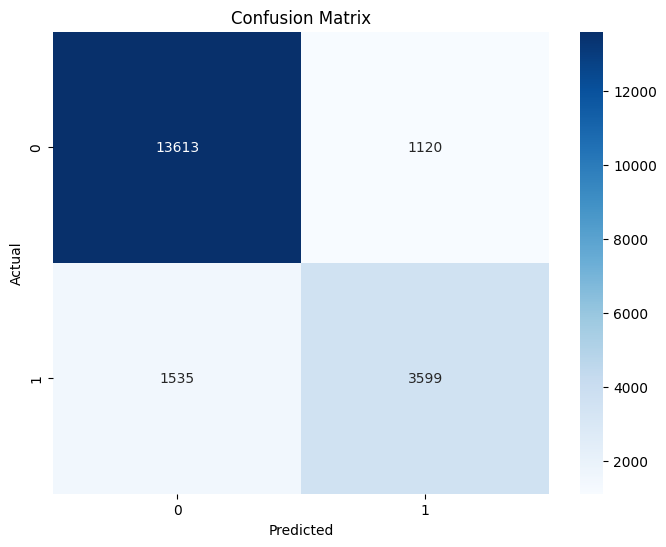

****************************************************************************************************


In [52]:
i = 1 # Initialize counter
for exp_model in exp_models: # Loop through the experimental models
    exp_model.to(device) # Move model to device
    print("*"*100)
    print(f"model_exp_{i}") # Print the model name
    fine_tune_model_no_plot(exp_model, train_dataset, validation_dataset, num_epochs, batch_size, learning_rate) # Fine-tune the model
    evaluate_model(exp_model, test_dataset, batch_size) # Evaluate the model
    torch.cuda.empty_cache() # Empty the cache
    print("*"*100) # Print a separator
    i += 1 # Increment counter

In [53]:
torch.cuda.empty_cache() # Clear the cache

## Results

The main model is trained on batch size 32 with a learning rate of 0.001 for two epochs.
Accuracy: 0.8643
Precision: 0.7141
Recall: 0.7922
F1 Score: 0.7511
AUC: 0.9305


Learning rate = 0.001:

| Batch Size \ Epochs | 1 | 3 |
|---------------------|---|---|
| 8 | Accuracy:0.8543<br>Precision:0.6918<br>Recall:0.7756<br>F1 Score:0.7313<br>AUC: 0.9215| Accuracy:0.8598<br>Precision:0.7128<br>Recall:0.7559<br>F1 Score:0.7337<br>AUC:0.9217 |
| 32 | Accuracy:0.8603<br>Precision:0.7487<br>Recall:0.6827<br>F1 Score:0.7142<br>AUC: 0.9268| Accuracy:0.8613<br>Precision:0.7166<br>Recall:0.7564<br>F1 Score:0.7360<br>AUC:0.9231 |
| 128 | Accuracy:0.8659<br>Precision:0.7506<br>Recall:0.7121<br>F1 Score:0.7308<br>AUC: 0.9289| Accuracy:0.8484<br>Precision:0.7718<br>Recall:0.5780<br>F1 Score:0.6610<br>AUC: 0.9149|

Learning rate = 0.01:

| Batch Size \ Epochs | 1 | 3 |
|---------------------|---|---|
| 8 | Accuracy:0.8229<br>Precision:0.6678<br>Recall:0.6111<br>F1 Score:0.632<br>AUC: 0.8822| Accuracy:0.8524<br>Precision:0.7096<br>Recall:0.7153<br>F1 Score:0.7124<br>AUC:0.9158 |
| 32 | Accuracy:0.8136<br>Precision:0.6327<br>Recall:0.6458<br>F1 Score:0.6392<br>AUC: 0.8731| Accuracy:0.8486<br>Precision:0.7849<br>Recall:0.5614<br>F1 Score:0.6546<br>AUC: 0.9193|
| 128 | Accuracy:0.8334<br>Precision:0.7359<br>Recall:0.5433<br>F1 Score:0.6251<br>AUC: 0.8913| Accuracy:0.8484<br>Precision:0.6724<br>Recall:0.7938<br>F1 Score:0.7281<br>AUC:0.9197 |

Learning rate = 0.1

| Batch Size \ Epochs | 1 | 3 |
|---------------------|---|---|
| 8 | Accuracy:0.7586<br>Precision:0.5630<br>Recall:0.2484<br>F1 Score:0.3447<br>AUC: 0.7713| Accuracy:0.7444<br>Precision:0.0000<br>Recall:0.0000<br>F1 Score:0.0000<br>AUC: 0.5000|
| 32 | Accuracy:0.8013<br>Precision:0.5869<br>Recall:0.7521<br>F1 Score:0.6593<br>AUC: 0.8706| Accuracy:0.8510<br>Precision:0.6857<br>Recall:0.7703<br>F1 Score:0.7255<br>AUC:0.9175 |
| 128 | Accuracy:0.7856<br>Precision:0.6144<br>Recall:0.4332<br>F1 Score:0.5081<br>AUC:0.8258 | Accuracy:0.8463<br>Precision:0.7186<br>Recall:0.6549<br>F1 Score:0.6853<br>AUC:0.9103 |

</br>

### Overfitting Trends
1. The data clearly shows signs of overfitting when moving from 2 to 3 epochs, particularly at lower learning rates. This is evident from the decreasing performance metrics (accuracy, AUC) when comparing 1 and 3 epochs across different batch sizes and learning rates.

### Learning Rate Optimization
2. The learning rate of 0.001 consistently outperforms 0.01 and 0.1 across various configurations. This suggests that 0.001 is close to an optimal learning rate for this particular model and dataset.

3. The highest learning rate (0.1) not only performs poorly but also leads to model collapse in some cases, particularly with 3 epochs and smaller batch sizes. This is seen in the 0.0000 values for precision, recall, and F1 score.

### Batch Size Impact
4. Larger batch sizes (32 and 128) generally yield better and more stable results compared to the smallest batch size (8). This is particularly noticeable in the accuracy and AUC metrics.

5. The positive impact of larger batch sizes is more pronounced at lower learning rates (0.001 and 0.01), suggesting a synergistic effect between appropriate learning rates and larger batch sizes.

### Metric Relationships
6. There's an observable trade-off between precision and recall across different configurations. As one increases, the other often decreases, affecting the F1 score.

7. AUC seems to be more robust to changes in hyperparameters compared to other metrics, showing less variance across different configurations.

### Optimal Configuration
8. Based on the provided data, the configuration that yields the best overall performance appears to be:
   - Learning rate: 0.001
   - Batch size: 32 or 128
   - Number of epochs: 2 (as stated for the main model)

This configuration provides a good balance of accuracy, precision, recall, and AUC while avoiding overfitting.

### Generalization
9. The model's ability to generalize seems to be best with 2 epochs. The performance degradation in accuracy seen when moving to 3 epochs suggests that the model starts to memorize the training data rather than learning generalizable patterns.

### Stability
10. Configurations with learning rate 0.001 and larger batch sizes (32, 128) show more stable performance across metrics and epochs, indicating a more reliable training process.

</br>

| Learnable Parameters | Metrics |
|--------------------|---------|
| Model A (11680104) | Accuracy:0.8686<br>Precision:0.7533<br>Recall:0.7308<br>F1 Score:0.7419<br>AUC: 0.9314|
| Model B (11679976) | Accuracy:0.8684<br>Precision:0.7597<br>Recall:0.7176<br>F1 Score:0.7381<br>AUC: 0.9313|
| Model C (11532008) | Accuracy:0.8589<br>Precision:0.6937<br>Recall:0.8130<br>F1 Score:0.7486<br>AUC: 0.9287|
| Model D (8906728) | Accuracy:0.8670<br>Precision:0.7529<br>Recall:0.7222<br>F1 Score:0.7373<br>AUC: 0.9300|
| Model E (513000) | Accuracy:0.8664<br>Precision:0.7627<br>Recall:0.7010<br>F1 Score:0.7305<br>AUC: 0.9288|

### Model complexity impact:

1. Despite significant differences in parameter count (from 513000 to 11680104), performance metrics are relatively close across all models. This suggests the task may not require extremely complex models to achieve good performance. The simpler models might be capturing the essential patterns in the data, while the additional parameters in larger models may be learning redundant information or overly specific details that don't generalize well to the test set.

### Accuracy consistency:

2. Accuracy scores are fairly consistent, ranging from 0.8589 to 0.8686. This suggests that the number of parameters are large enough to adapt to the dataset.

### Model efficiency:

3. Model E has significantly fewer parameters (513000) compared to others but achieves competitive performance. This suggests that the number of parameters are large enough to adapt to the dataset.

### AUC stability:

4. AUC scores show little variation across models (0.9287 to 0.9314). This indicates that all models have similar discriminative power and perform well across different classification thresholds.

### Precision-recall trade-off:

5. Model C has the highest recall (0.8130) but lowest precision (0.6937), while Model E has the highest precision (0.7627) but lowest recall (0.7010). This trade-off likely results from different classification thresholds or model architectures. Model C appears to be more sensitive, correctly identifying more positive cases (high recall) but at the cost of more false positives (lower precision). Model E is more conservative, making fewer positive predictions but with higher confidence.

### Model complexity vs. dataset size:

The number of learnable parameters in all models (ranging from 513,000 to 11,680,104) is likely much larger than the size of the dataset. When the number of parameters significantly exceeds the amount of training data, it can lead to several effects:

a) Overfitting risk: Models with many more parameters than data points can potentially memorize the training set rather than learning generalizable patterns. This could explain why increasing model complexity doesn't yield proportional performance improvements.

b) Diminishing returns: Beyond a certain point, adding more parameters may not provide additional meaningful capacity to learn from a limited dataset. This could explain the similar performance across models of varying complexity.

c) Regularization importance: The fact that larger models aren't performing worse suggests that effective regularization techniques (like dropout, weight decay, or early stopping) are likely being employed to prevent severe overfitting.

d) Underutilized capacity: Many of the parameters in the larger models may be redundant or underutilized due to insufficient data to fully leverage them. This could explain why Model E, with fewer parameters, performs competitively.

e) Data efficiency: The similarity in performance across models suggests that the smaller models are more data-efficient, extracting most of the learnable information from the available dataset.

### Impact of model size on different metrics:

Despite the large variation in model sizes (from 513,000 to 11,680,104 parameters), the impact on different performance metrics is not uniform. This non-uniform impact across metrics reveals important insights about the relationship between model complexity and different aspects of performance:

a) Accuracy and AUC: These metrics show the least variation across models (accuracy range: 0.8589 to 0.8686, AUC range: 0.9287 to 0.9314). This suggests that overall discriminative power and general correctness are less sensitive to model size for this task.

b) Precision and Recall: These metrics show more notable variations (precision range: 0.6937 to 0.7627, recall range: 0.7010 to 0.8130). This indicates that model size and architecture have a more pronounced effect on the balance between false positives and false negatives.

c) F1 Score: As a harmonic mean of precision and recall, the F1 score variations (0.7305 to 0.7486) reflect the precision-recall trade-offs across different model sizes.

# Question 2
Capture a photo of yourself, similar to the dataset mentioned above, and visualize the activation maps and filters at various layers of the model trained in Question 1. Then, conduct an occlusion experiment to examine the impact on the model's predictions. [I hope you won't copy this 😀]

### Loading the image and preprocessing

In [54]:
main_model_loaded = torch.load('main_model.pth') # Load the model
print(summary(main_model_loaded, input_size=(1, 3, 224, 224))) # Print the model summary
main_model_loaded.to(device)  # Move model to the GPU if available

Layer (type:depth-idx)                   Output Shape              Param #
ResNet                                   [1, 1]                    --
├─Conv2d: 1-1                            [1, 64, 112, 112]         9,408
├─BatchNorm2d: 1-2                       [1, 64, 112, 112]         128
├─ReLU: 1-3                              [1, 64, 112, 112]         --
├─MaxPool2d: 1-4                         [1, 64, 56, 56]           --
├─Sequential: 1-5                        [1, 64, 56, 56]           --
│    └─BasicBlock: 2-1                   [1, 64, 56, 56]           --
│    │    └─Conv2d: 3-1                  [1, 64, 56, 56]           36,864
│    │    └─BatchNorm2d: 3-2             [1, 64, 56, 56]           128
│    │    └─ReLU: 3-3                    [1, 64, 56, 56]           --
│    │    └─Conv2d: 3-4                  [1, 64, 56, 56]           36,864
│    │    └─BatchNorm2d: 3-5             [1, 64, 56, 56]           128
│    │    └─ReLU: 3-6                    [1, 64, 56, 56]           --
│

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.64].


Image successfully downloaded: my_image.jpeg
Image is not corrupted.


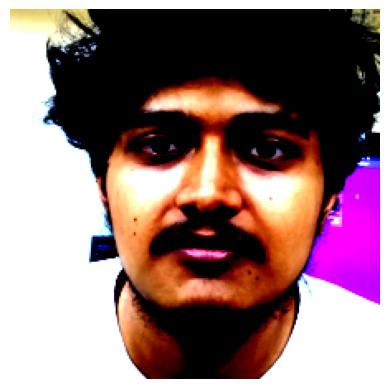

torch.Size([1, 3, 224, 224])
-1.6979371309280396
Probability of me having Arched Eyebrows is: 0.1547
It has been predicted that I do not have Arched Eyebrows.


In [55]:
# Dropbox link for direct download
my_image_link = "https://www.dropbox.com/scl/fi/fshjsm952vuqm4i0f7mwl/Image.jpeg?rlkey=a5cyxsignlxp05ysfuo064mqs&st=suybxoqy&dl=1"

response = requests.get(my_image_link) # Make a GET request to the image link
save_path = "my_image.jpeg" # Path to save the image

# Check if the request was successful
if response.status_code == 200: # If successful
    # Open the file in binary write mode and save the content
    with open(save_path, 'wb') as file: # Open the file in binary write mode
        file.write(response.content) # Write the content
    print(f"Image successfully downloaded: {save_path}") # Print a success message
else: # If unsuccessful
    print(f"Failed to download image. Status code: {response.status_code}") #
    raise Exception("Failed to download image.") # Raise an exception

# Check is my_image.jpeg is not corrupted
try:
    img = Image.open(save_path) # Open the image
    img.verify() # Verify the image
    print("Image is not corrupted.") # Print a message saying that the image is not corrupted
except (IOError, SyntaxError) as e: # If the image is corrupted
    print("Image is corrupted.") # Print a message saying that the image is corrupted
    raise Exception("Please use a different image.") # Raise an exception

# Preprocessing steps to prepare the image for ResNet-18
def preprocess_image(image_path): # Preprocess the image
    preprocess = transforms.Compose([ # Compose transformations
        transforms.Resize(256), # Resize the image
        transforms.CenterCrop(224), # Center crop the image
        transforms.ToTensor(), # Convert image to tensor
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]), # Normalize with ImageNet stats
    ])
    image = Image.open(image_path) # Open the image
    image_tensor = preprocess(image).unsqueeze(0)  # Add batch dimension
    return image_tensor # Return the image tensor

my_image_tensor = preprocess_image(save_path) # Preprocess the image

# Plot my_image_tensor

def plot_tensor(tensor): # Plot the image tensor
    image = tensor.squeeze(0).permute(1, 2, 0) # Squeeze the tensor and permute dimensions
    plt.imshow(image) # Display the image
    plt.axis('off') # Turn off axis
    plt.show() # Show the plot

plot_tensor(my_image_tensor) # Plot the image tensor
print(my_image_tensor.shape) # Print the shape of the image tensor

# Function to run the model on the image
def run_model_on_image(model, image_tensor): # Run the model on the image
    model.eval()  # Set the model to evaluation mode
    image_tensor = image_tensor.to(device)  # Move the input tensor to the same device as the model
    with torch.no_grad(): # No need to calculate gradients
        output = model(image_tensor) # Forward pass
    return output.item(), torch.sigmoid(output).item() # Return the output

num, probability = run_model_on_image(main_model_loaded, my_image_tensor) # Run the model on the image
print(num) # Print the output
print(f"Probability of me having Arched Eyebrows is: {probability:.4f}") # Print the probability

if probability > 0.5: # If probability is greater than 0.5
    print("It has been predicted that I have Arched Eyebrows.") # Print a message saying that Arched Eyebrows are present
else: # If probability is less than or equal to 0.5
    print("It has been predicted that I do not have Arched Eyebrows.") # Print a message saying that Arched Eyebrows are not present

### Visualizing Filters

In [56]:
# filters is a list of layers for which we want to visualize the filters
filters = [
        main_model_loaded.conv1, main_model_loaded.layer1[0].conv1, main_model_loaded.layer1[0].conv2, main_model_loaded.layer1[1].conv1, main_model_loaded.layer1[1].conv2,
        main_model_loaded.layer2[0].conv1, main_model_loaded.layer2[0].conv2, main_model_loaded.layer2[0].downsample[0], main_model_loaded.layer2[1].conv1, main_model_loaded.layer2[1].conv2,
        main_model_loaded.layer3[0].conv1, main_model_loaded.layer3[0].conv2, main_model_loaded.layer3[0].downsample[0], main_model_loaded.layer3[1].conv1, main_model_loaded.layer3[1].conv2,
        main_model_loaded.layer4[0].conv1, main_model_loaded.layer4[0].conv2, main_model_loaded.layer4[0].downsample[0], main_model_loaded.layer4[1].conv1, main_model_loaded.layer4[1].conv2
    ]
# layer_names is a list of names for each layer
layer_names = [
        'conv1', 'layer1.0.conv1', 'layer1.0.conv2', 'layer1.1.conv1', 'layer1.1.conv2',
        'layer2.0.conv1', 'layer2.0.conv2', 'layer2.0.downsample', 'layer2.1.conv1', 'layer2.1.conv2',
        'layer3.0.conv1', 'layer3.0.conv2', 'layer3.0.downsample', 'layer3.1.conv1', 'layer3.1.conv2',
        'layer4.0.conv1', 'layer4.0.conv2', 'layer4.0.downsample', 'layer4.1.conv1', 'layer4.1.conv2'
    ]

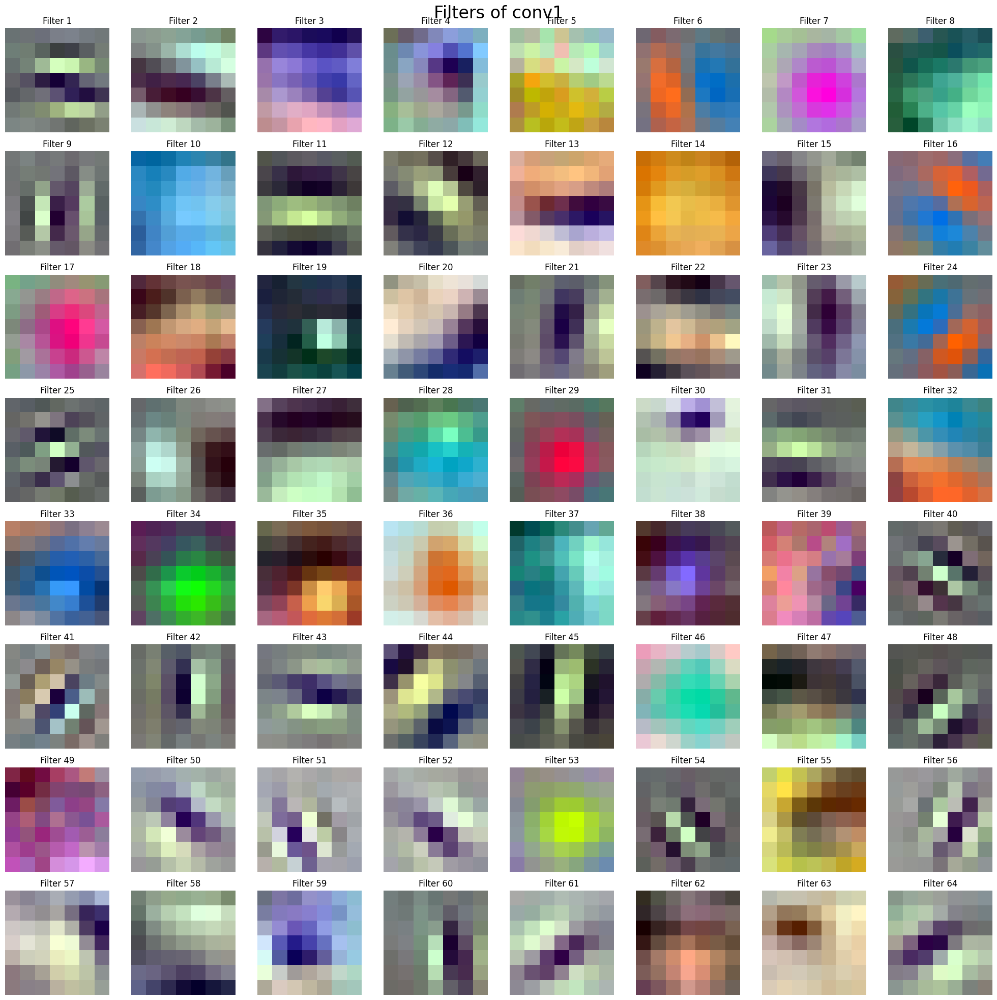

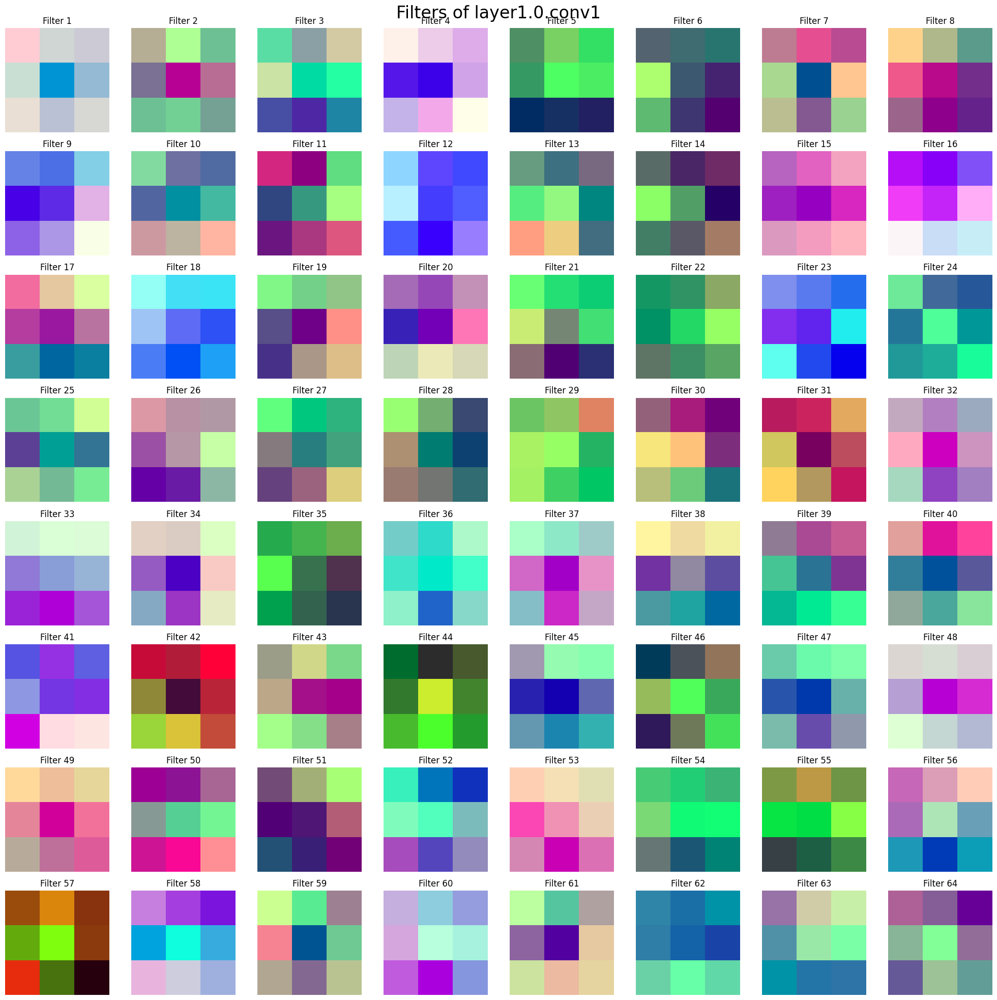

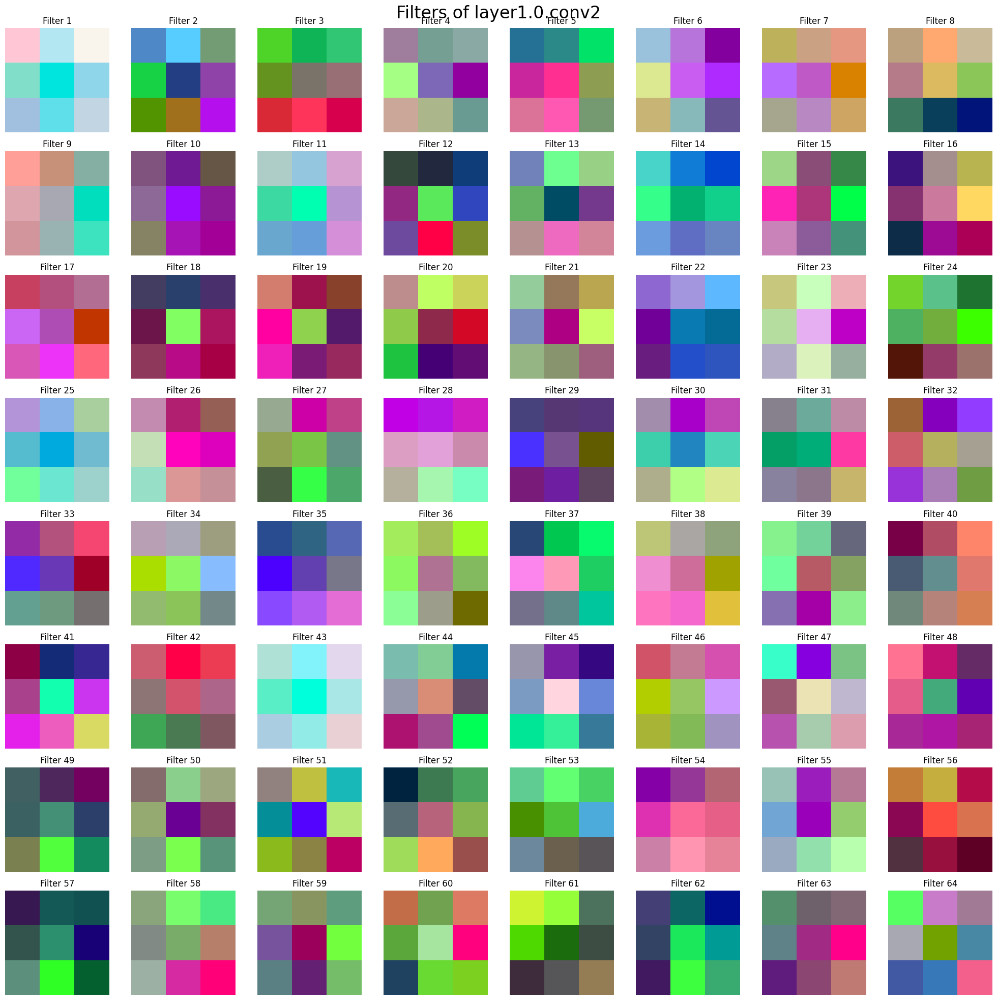

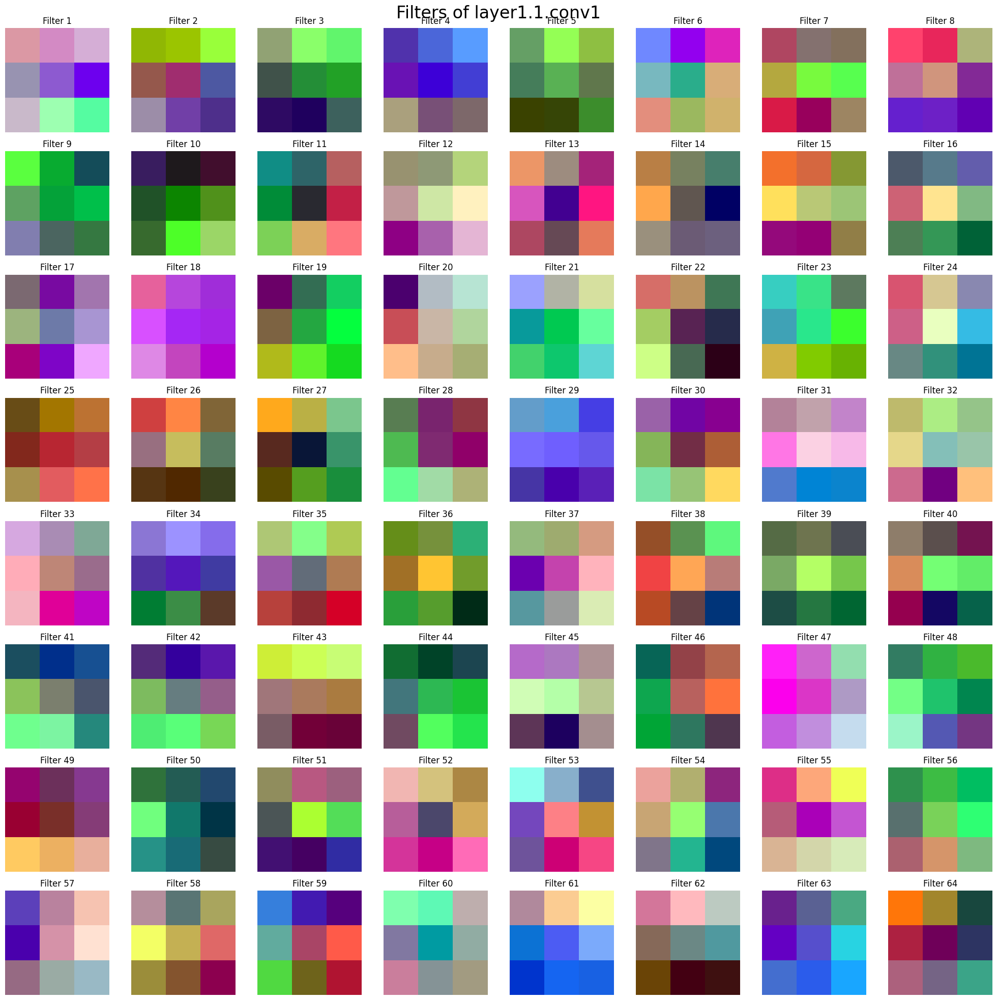

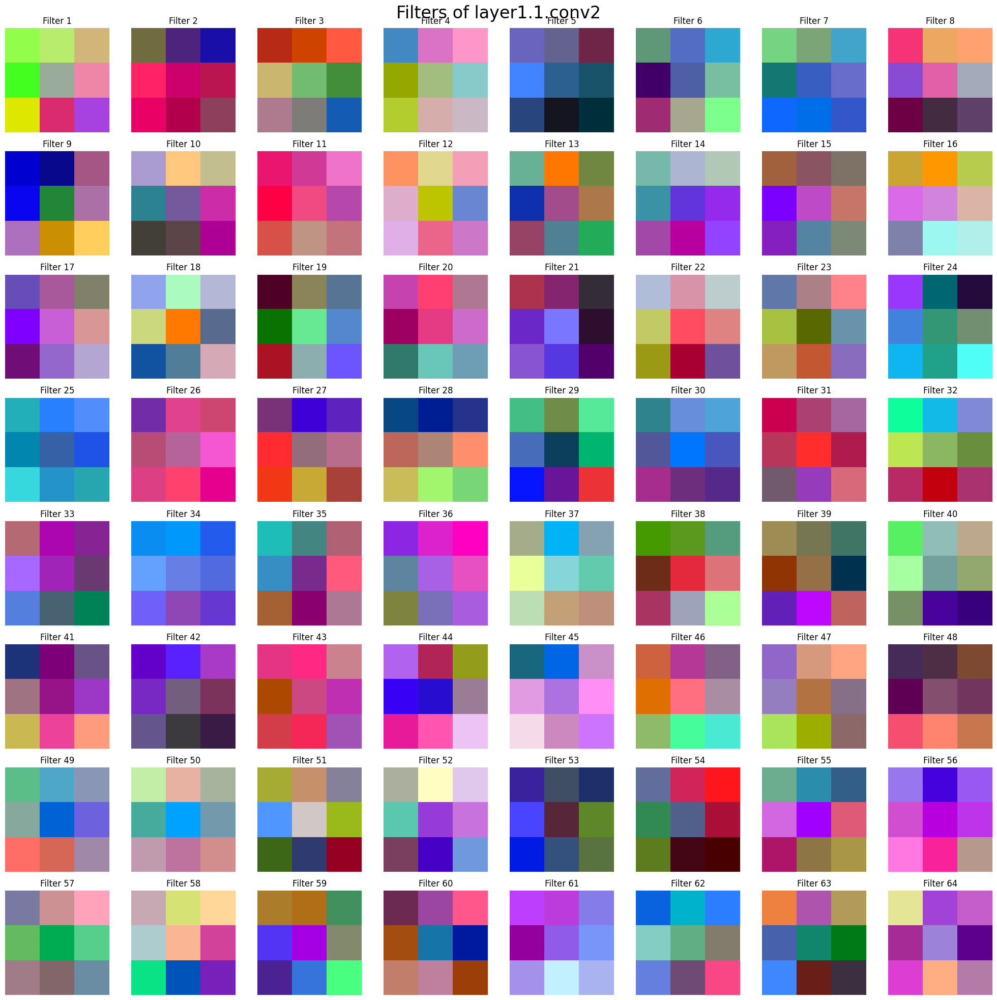

...

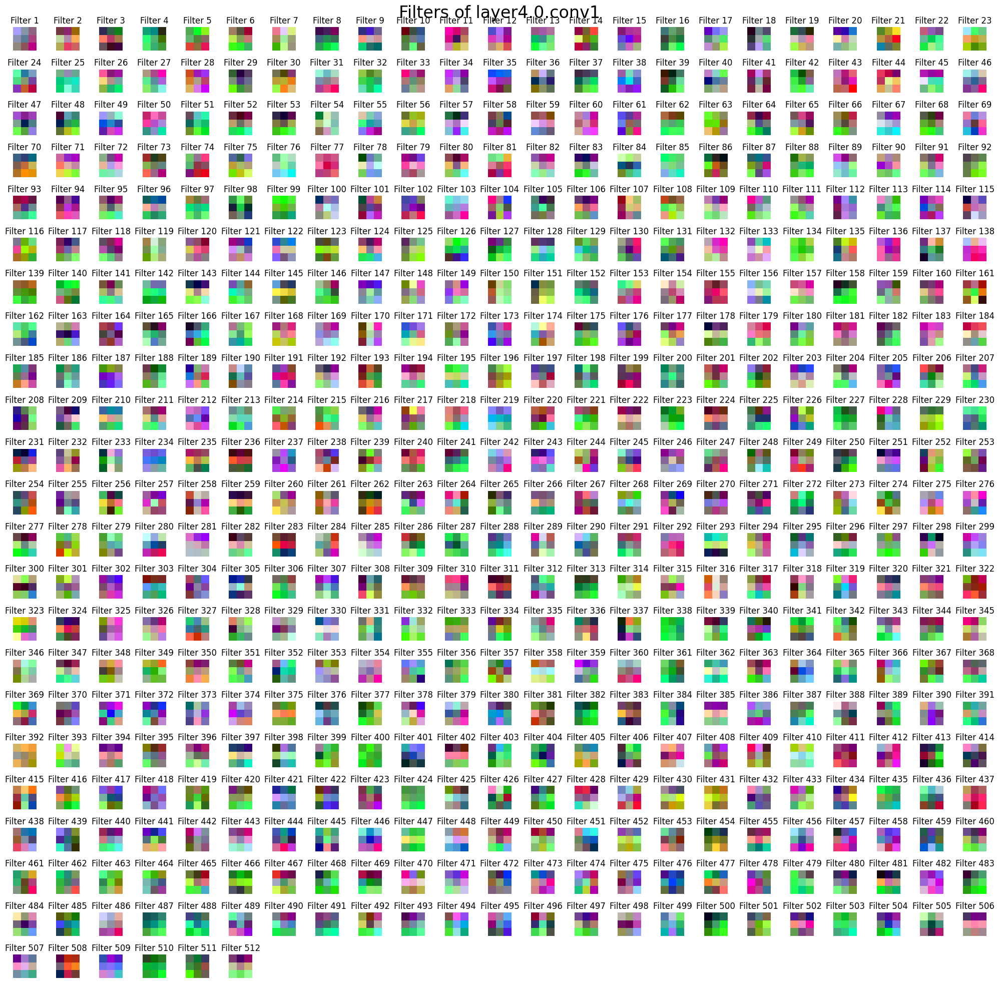

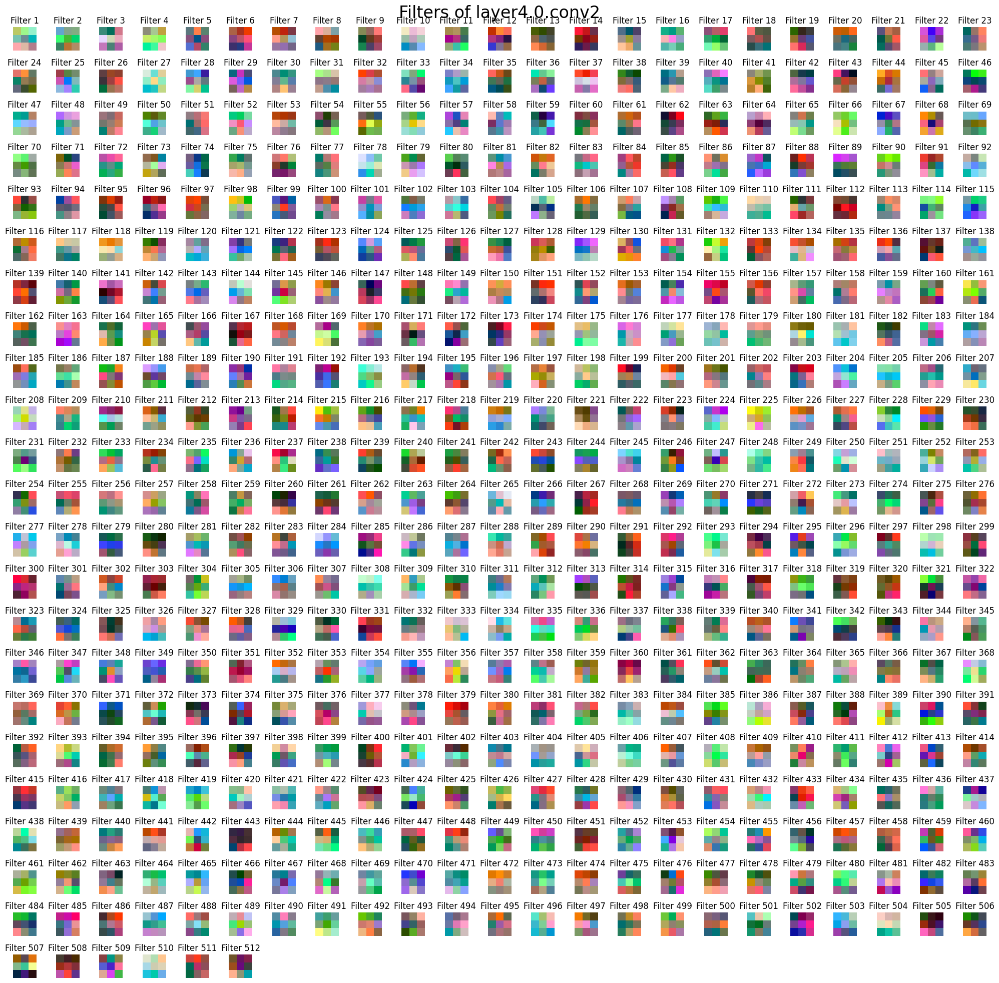

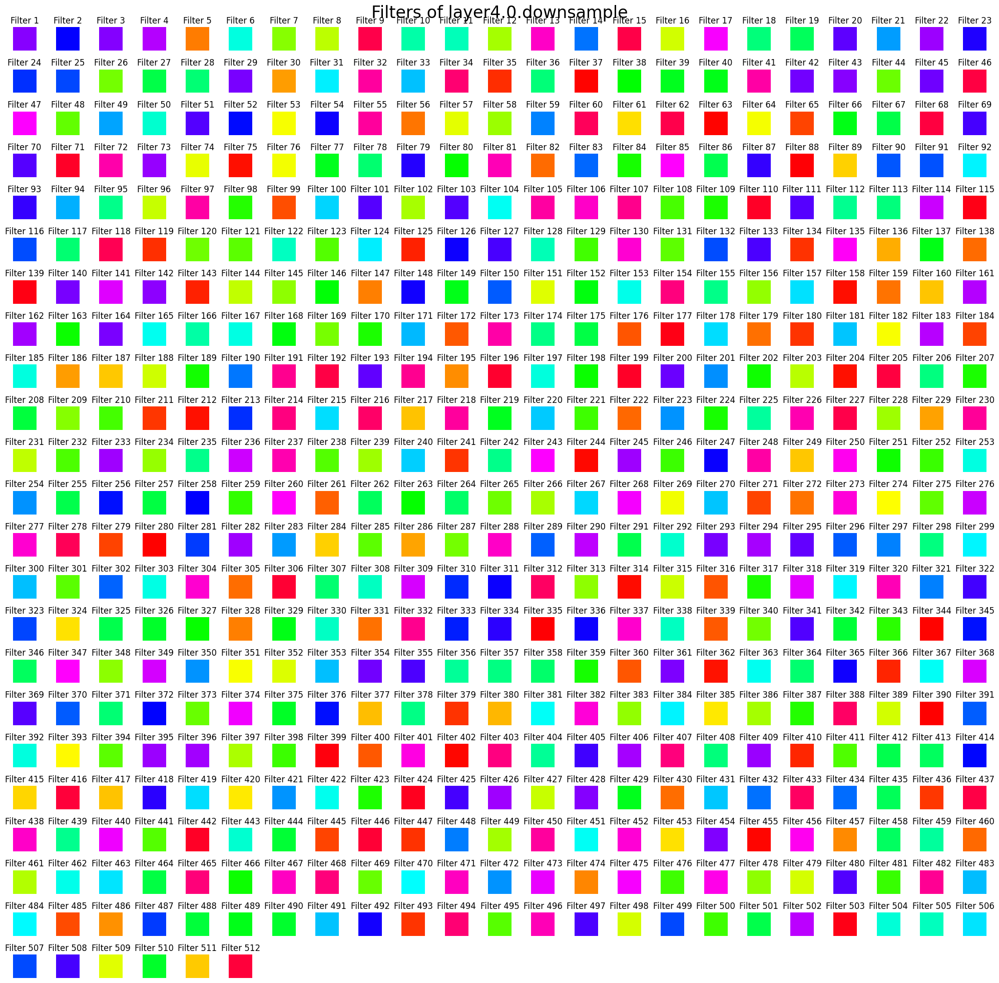

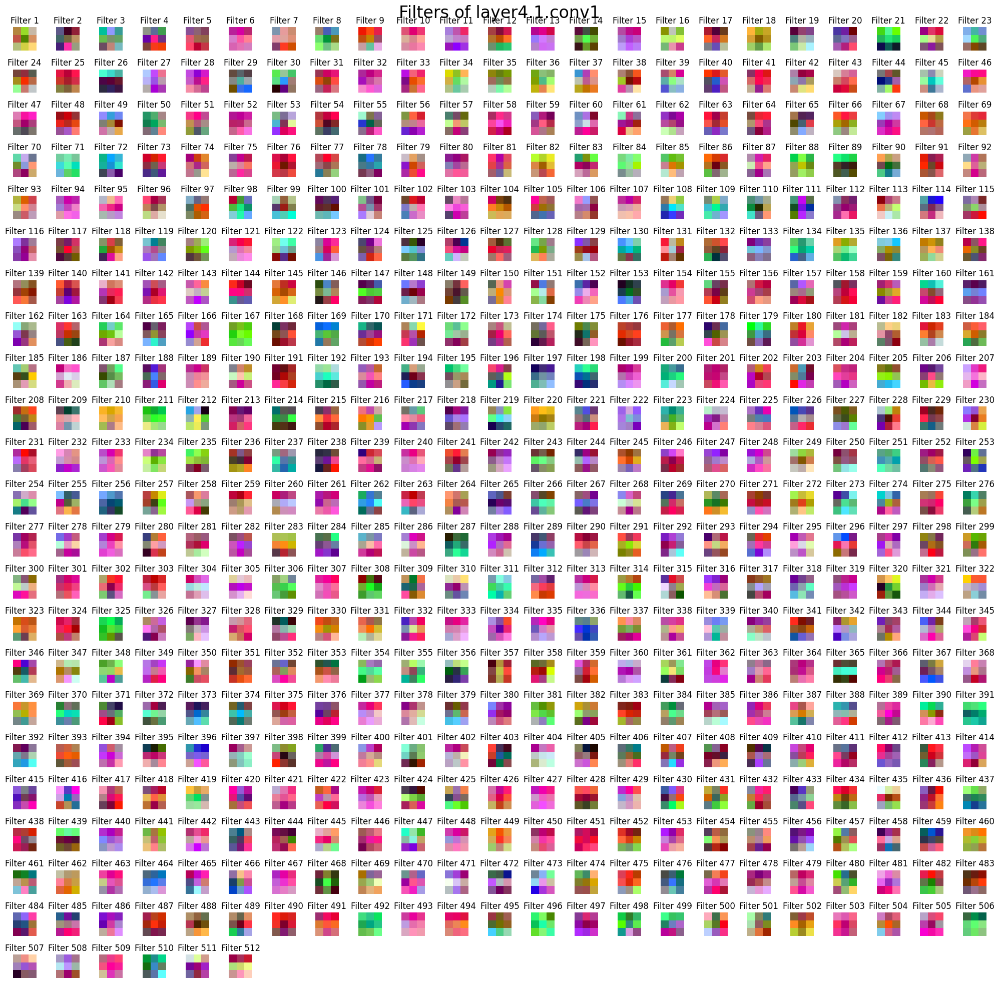

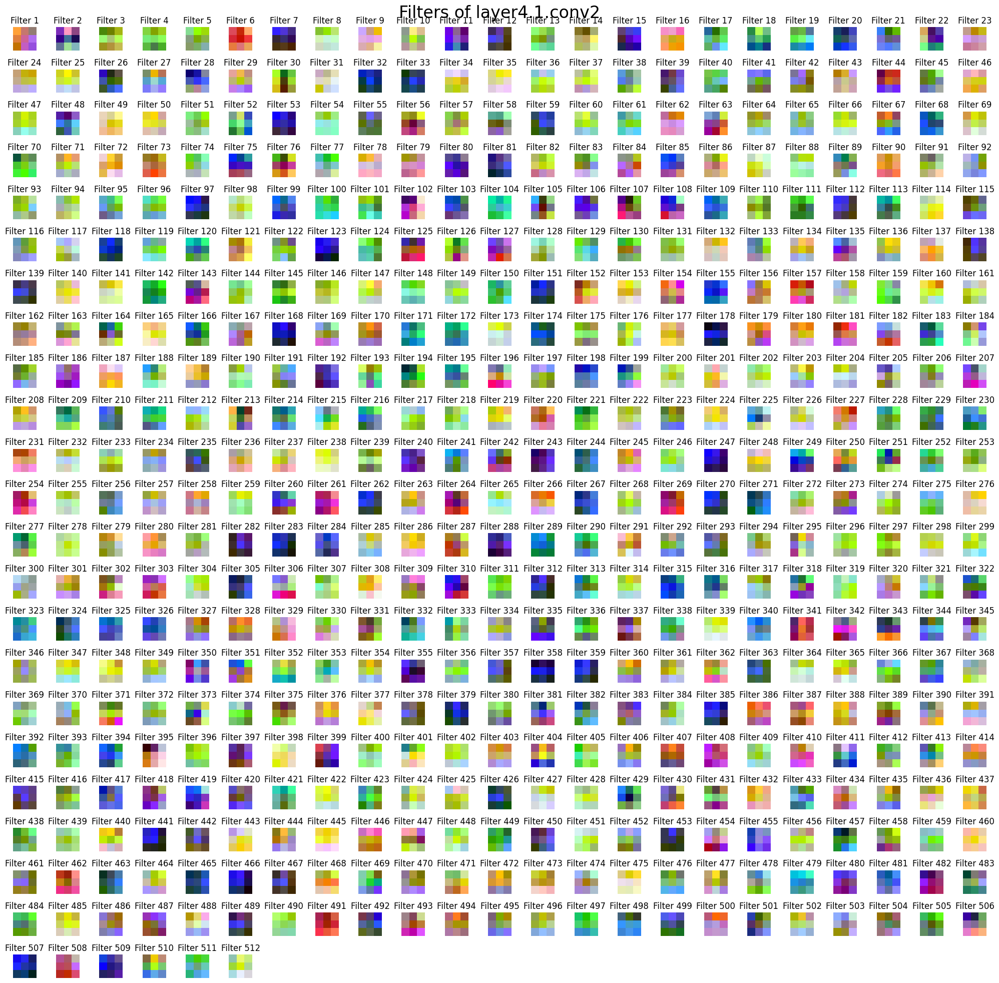

In [57]:
def visualize_all_filters(model): # Visualize all filters

    for layer, name in zip(filters, layer_names): # Loop through each layer and name
        weights = layer.weight.data.cpu() # Get the weights of the layer
        num_filters = weights.size(0) # Get the number of filters
        grid_size = math.ceil(math.sqrt(num_filters)) # Calculate the grid size
        fig, axs = plt.subplots(grid_size, grid_size, figsize=(20, 20)) # Create a figure with subplots
        fig.suptitle(f"Filters of {name}", fontsize=24) # Set the title of the figure
        
        for i in range(num_filters): # Loop through each filter
            ax = axs[i // grid_size, i % grid_size] # Get the current axis
            
            if weights.size(1) == 3:  # For RGB input channels
                img = weights[i].permute(1, 2, 0).numpy() # Permute the dimensions and convert to numpy
            else:  # For layers with more than 3 input channels
                # Take first 3 channels or pad with zeros
                img = torch.zeros(3, *weights.shape[2:]) # Create a tensor of zeros
                img[:weights.size(1)] = weights[i, :3] # Copy the weights to the tensor
                img = img.permute(1, 2, 0).numpy() # Permute the dimensions and convert to numpy
            img = (img - img.min()) / (img.max() - img.min()) # Normalize the image
            
            # Display the image
            ax.imshow(img) # Display the image
            ax.axis('off') # Turn off axis
            ax.set_title(f'Filter {i+1}') # Set the title of the axis
        
        # Remove any unused subplots
        for i in range(num_filters, grid_size * grid_size): # Loop through unused subplots
            fig.delaxes(axs.flatten()[i]) # Remove the subplot
        
        plt.tight_layout() # Adjust layout
        plt.show() # Show the plot

visualize_all_filters(main_model_loaded) # Visualize all filters

### Visualizing Activation Maps

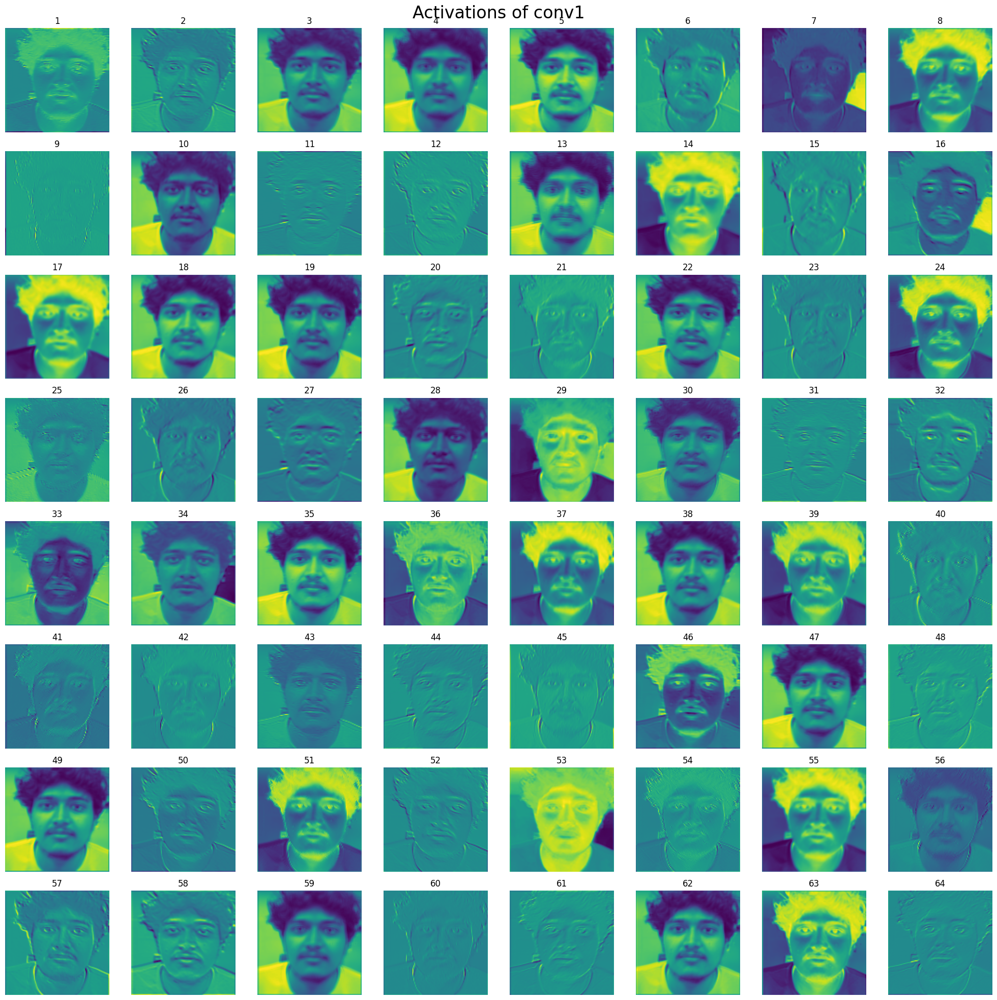

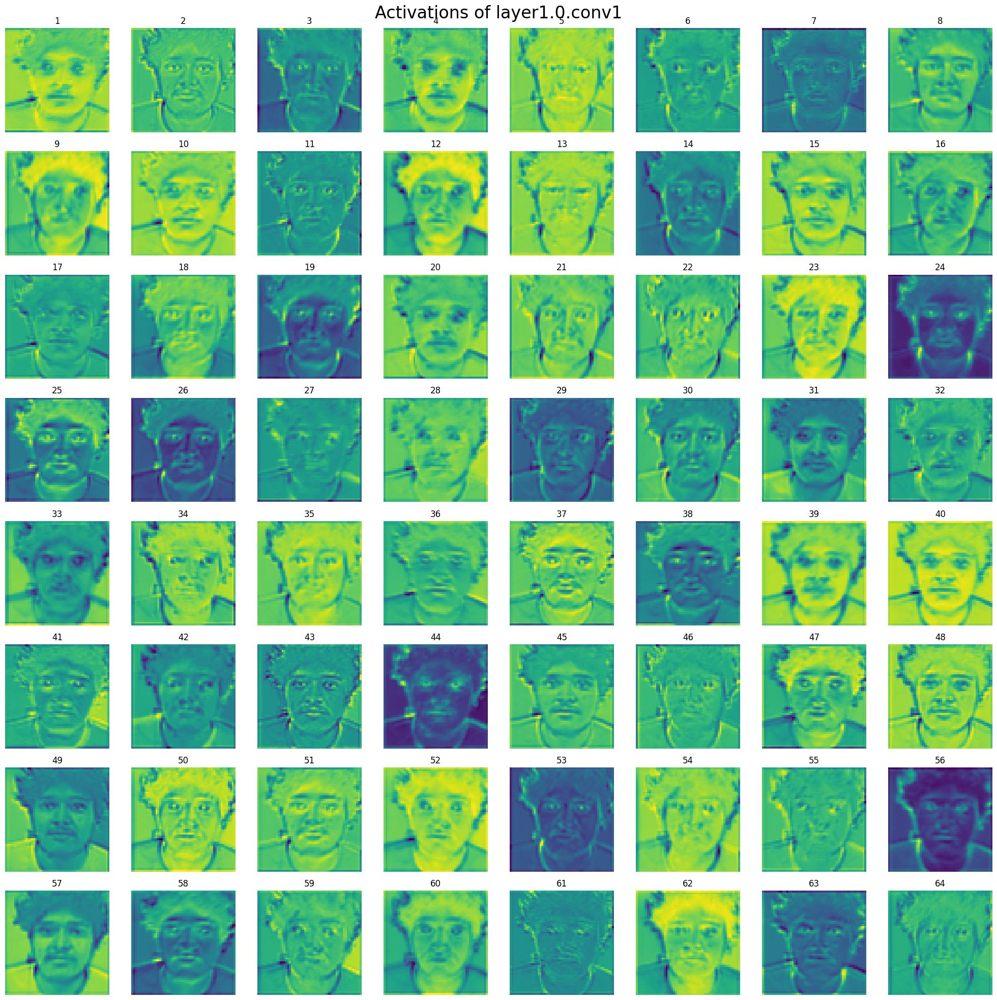

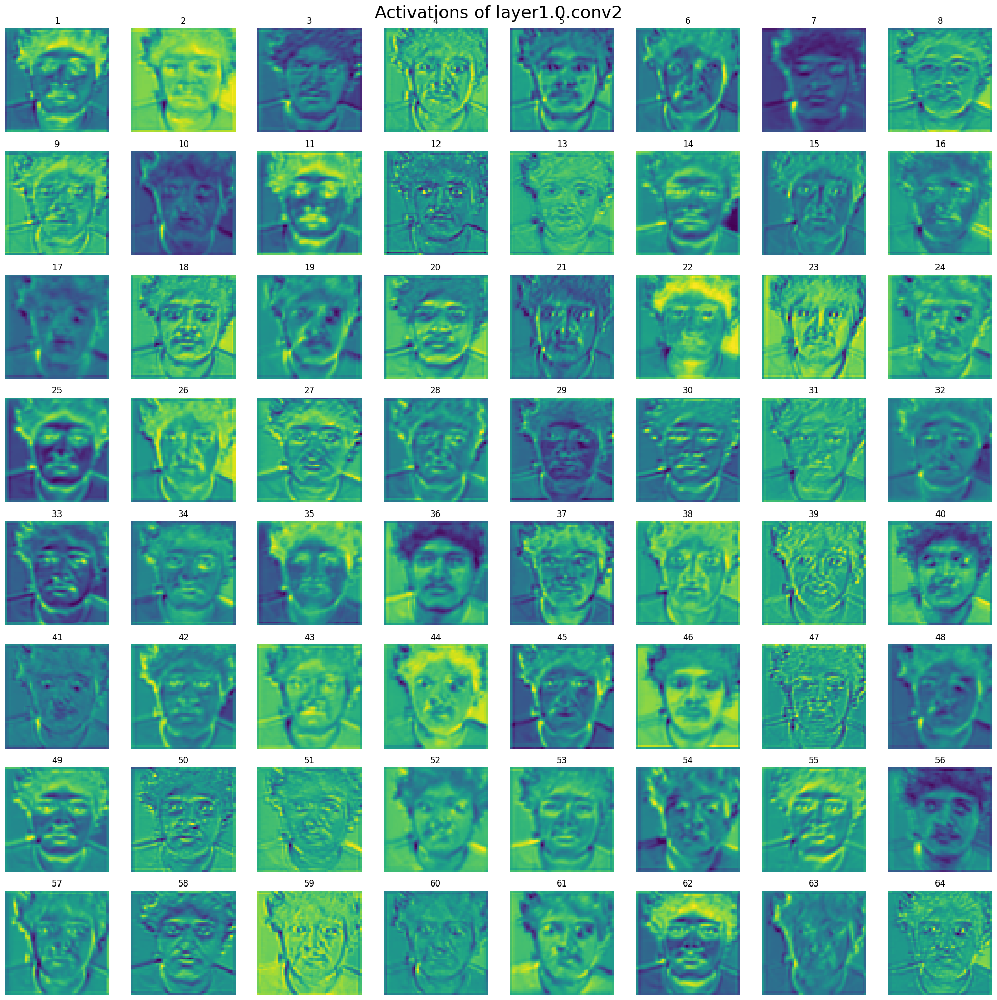

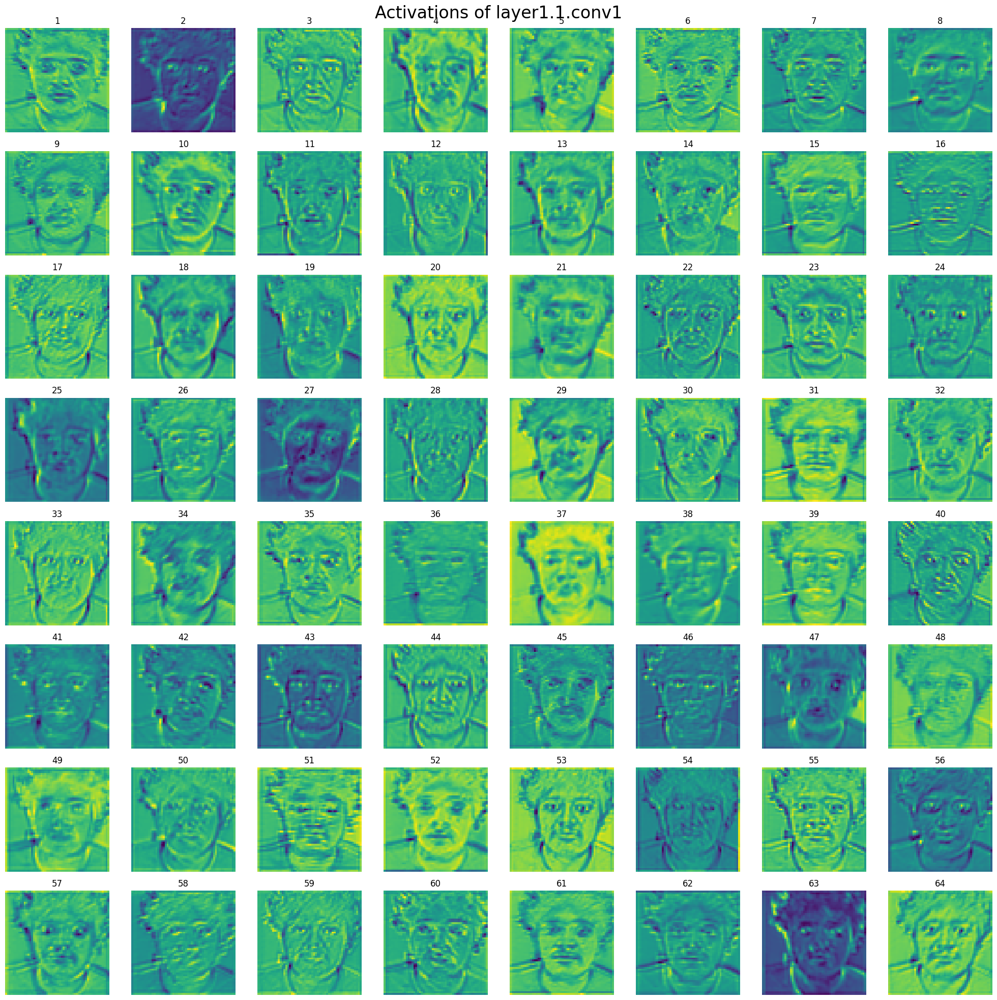

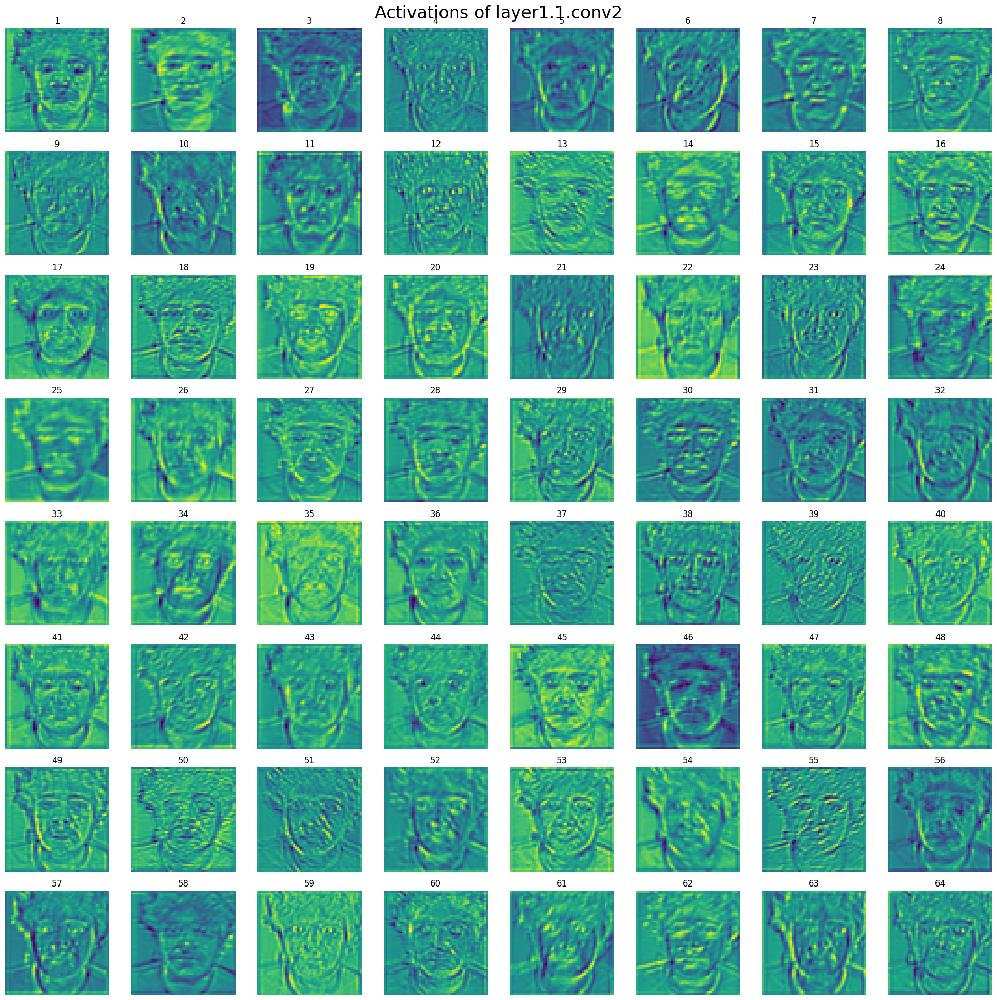

...

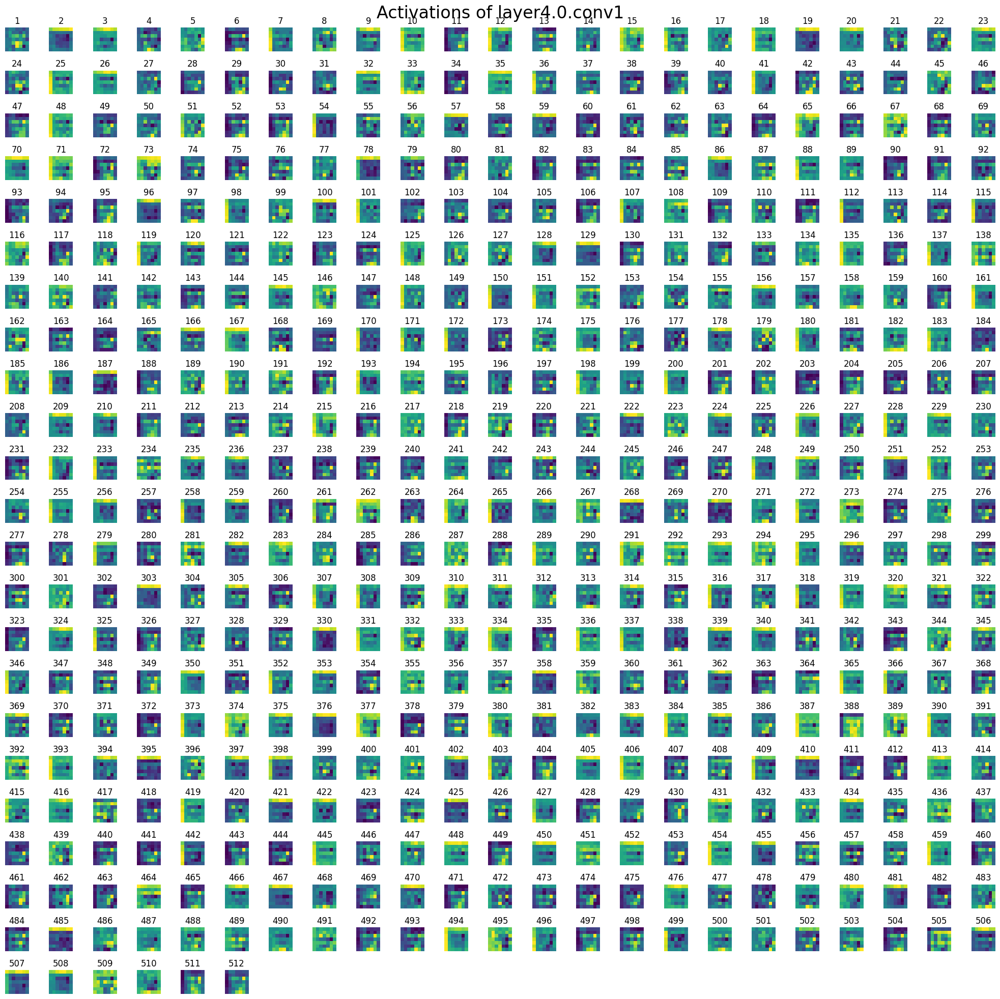

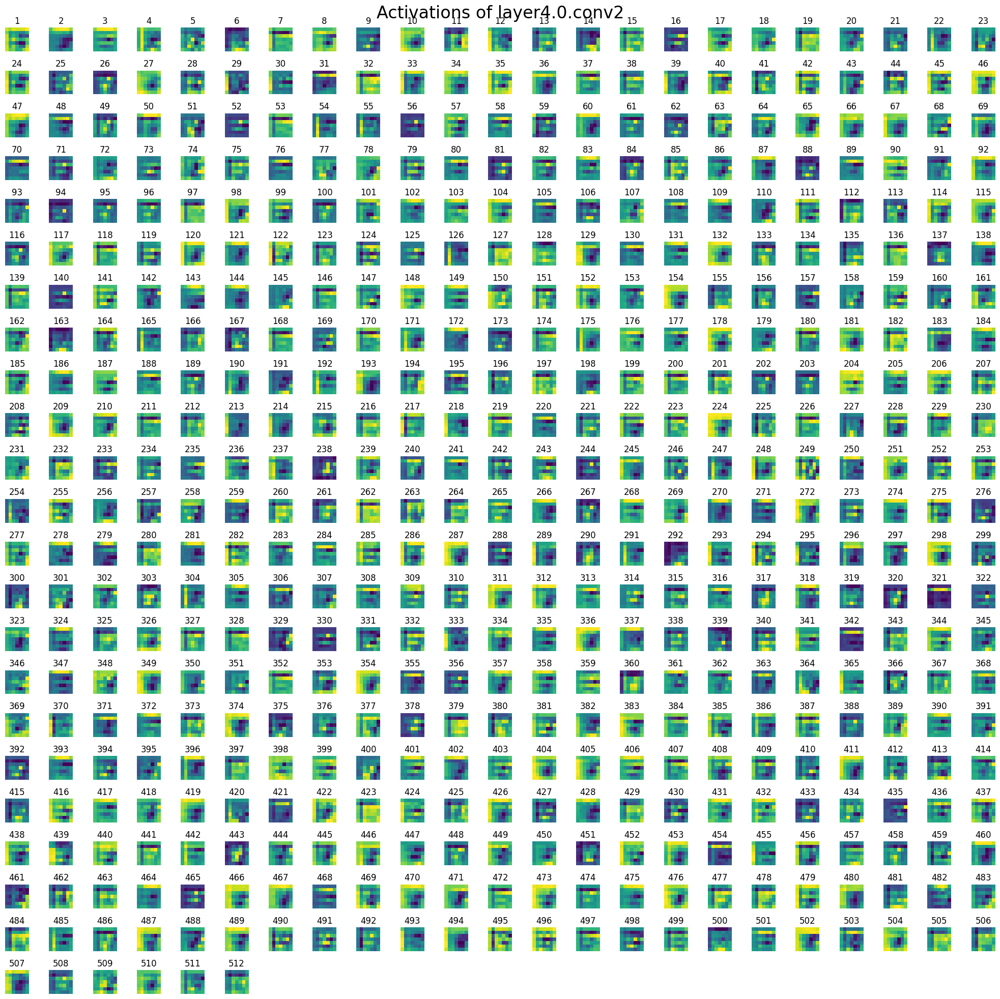

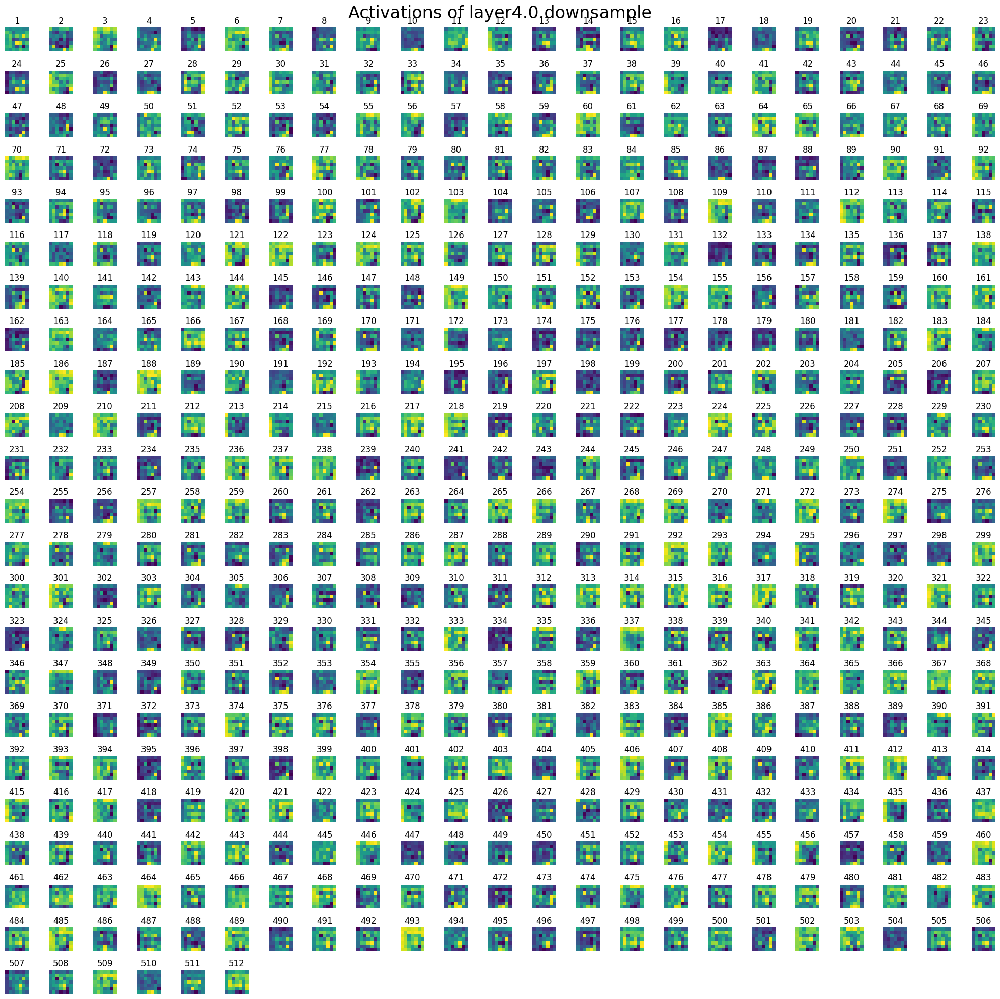

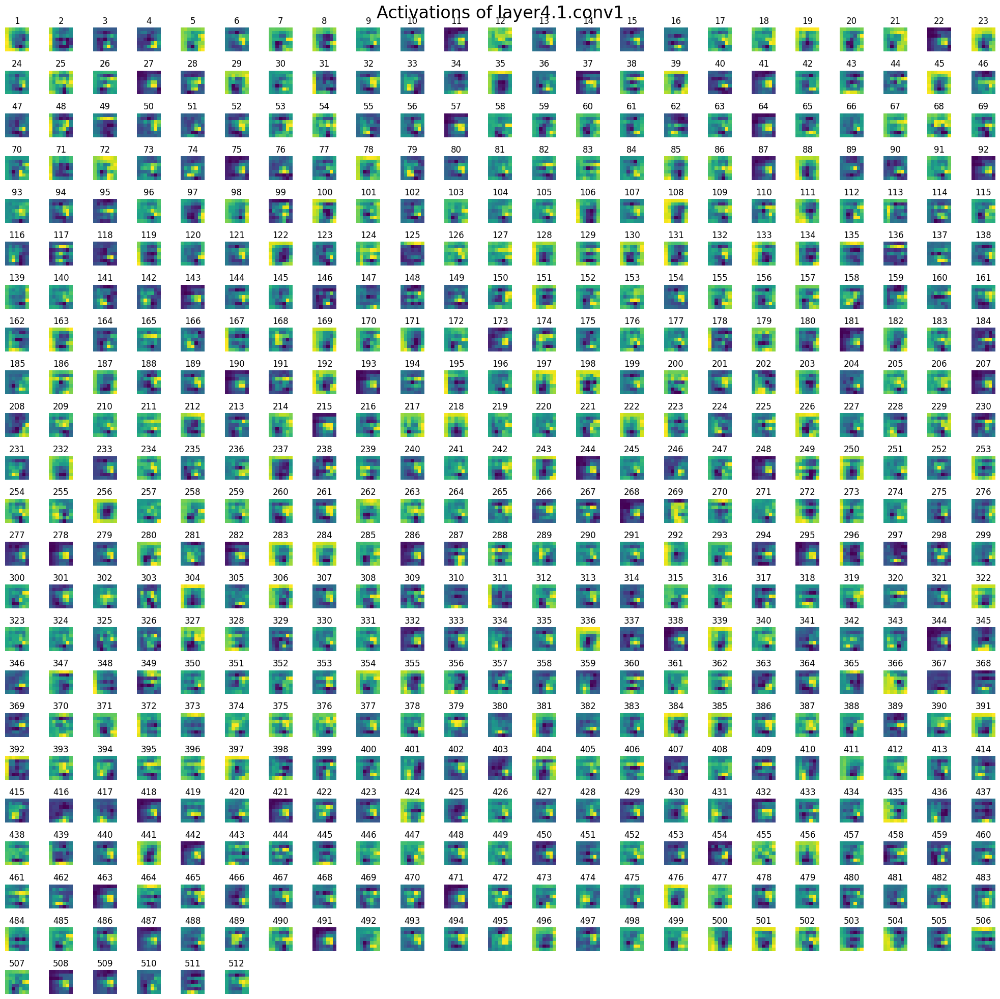

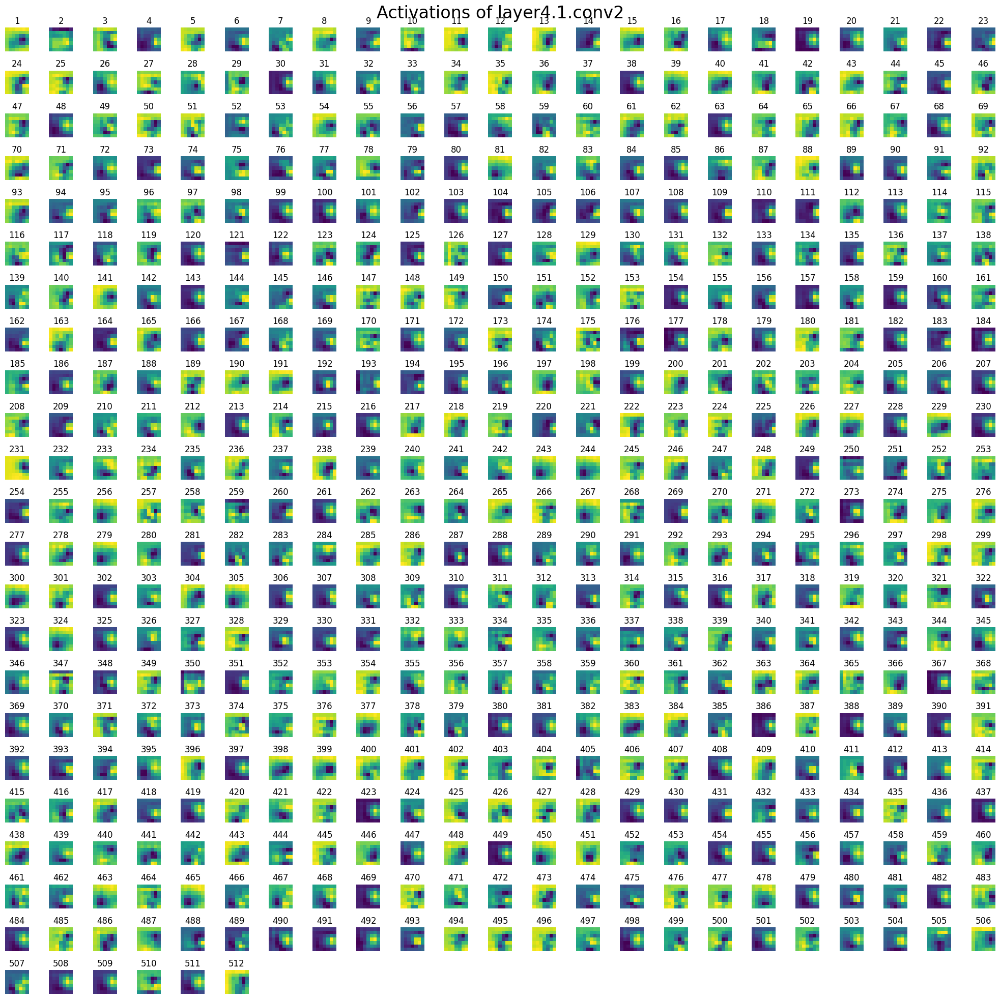

In [58]:
def visualize_all_activations(model, image): # Visualize all activations
    model.eval() # Set the model to evaluation mode
    image = image.to(device) # Move the image to the device
    activations = [] # List to store activations
    
    def hook(module, input, output): # Hook function to store activations
        activations.append(output) # Append the output to the list
    
    hooks = [] # List to store hooks
    for layer in filters: # Loop through each layer
        hooks.append(layer.register_forward_hook(hook)) # Register the hook
    
    with torch.no_grad(): # No need to calculate gradients
        model(image) # Forward pass
    
    for hook in hooks: # Loop through each hook
        hook.remove() # Remove the hook
    
    for layer, name, activation in zip(filters, layer_names, activations): # Loop through each layer, name, and activation
        num_activations = activation.size(1) # Calculate the number of activations
        grid_size = math.ceil(math.sqrt(num_activations)) # Calculate the grid size
        
        fig, axs = plt.subplots(grid_size, grid_size, figsize=(20, 20)) # Create a figure with subplots
        fig.suptitle(f"Activations of {name}", fontsize=24) # Set the title of the figure
        
        for i in range(num_activations): # Loop through each activation
            ax = axs[i // grid_size, i % grid_size] # Get the current axis
            img = activation[0, i].cpu() # Get the activation and move it to the CPU
            img = (img - img.min()) / (img.max() - img.min()) # Normalize the image
            ax.imshow(img) # Display the image
            ax.axis('off') # Turn off axis
            ax.set_title(f'{i+1}') # Set the title of the axis
        
        # Remove any unused subplots
        for i in range(num_activations, grid_size * grid_size): # Loop through unused subplots
            fig.delaxes(axs.flatten()[i]) # Remove the subplot
        
        plt.tight_layout() # Adjust layout
        plt.show() # Show the plot
        plt.close(fig)  # Close the figure to free memory

    # Clear the activations list to free memory
    activations.clear()

visualize_all_activations(main_model_loaded, my_image_tensor)

### Visualizing Heat Maps

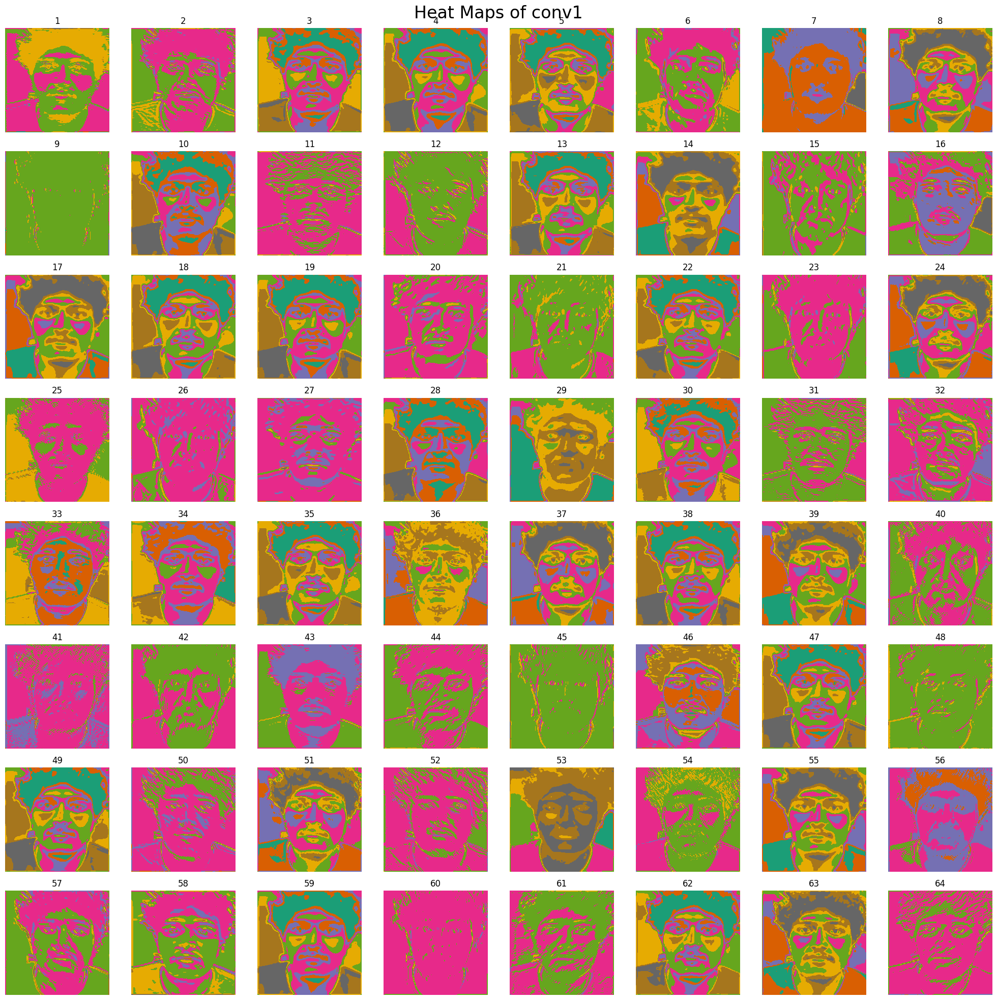

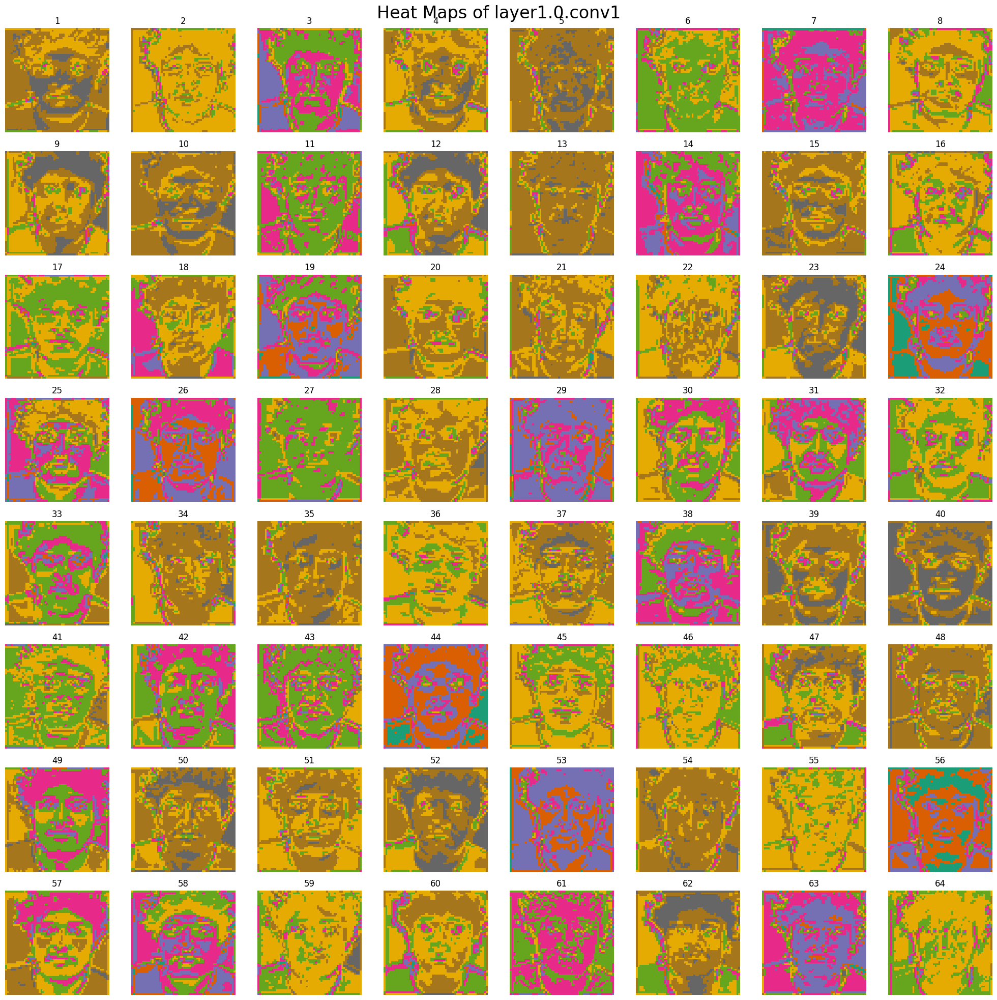

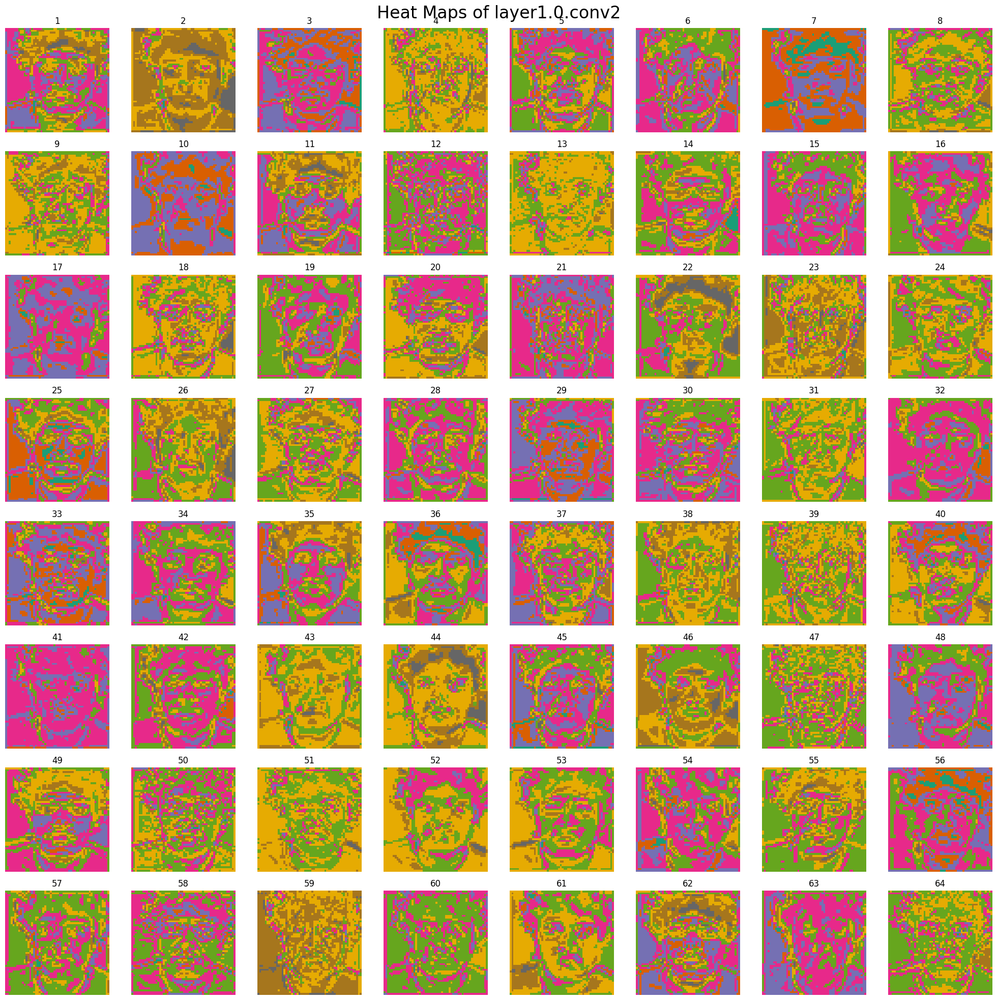

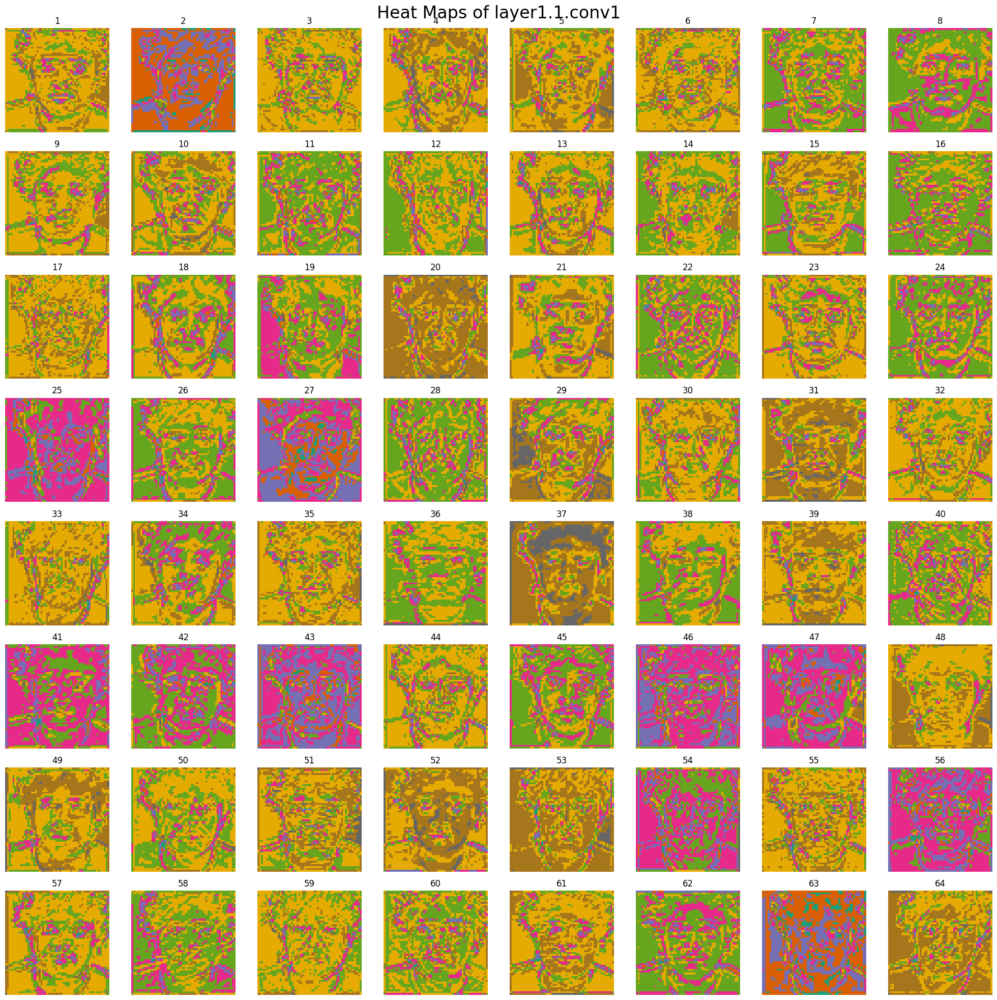

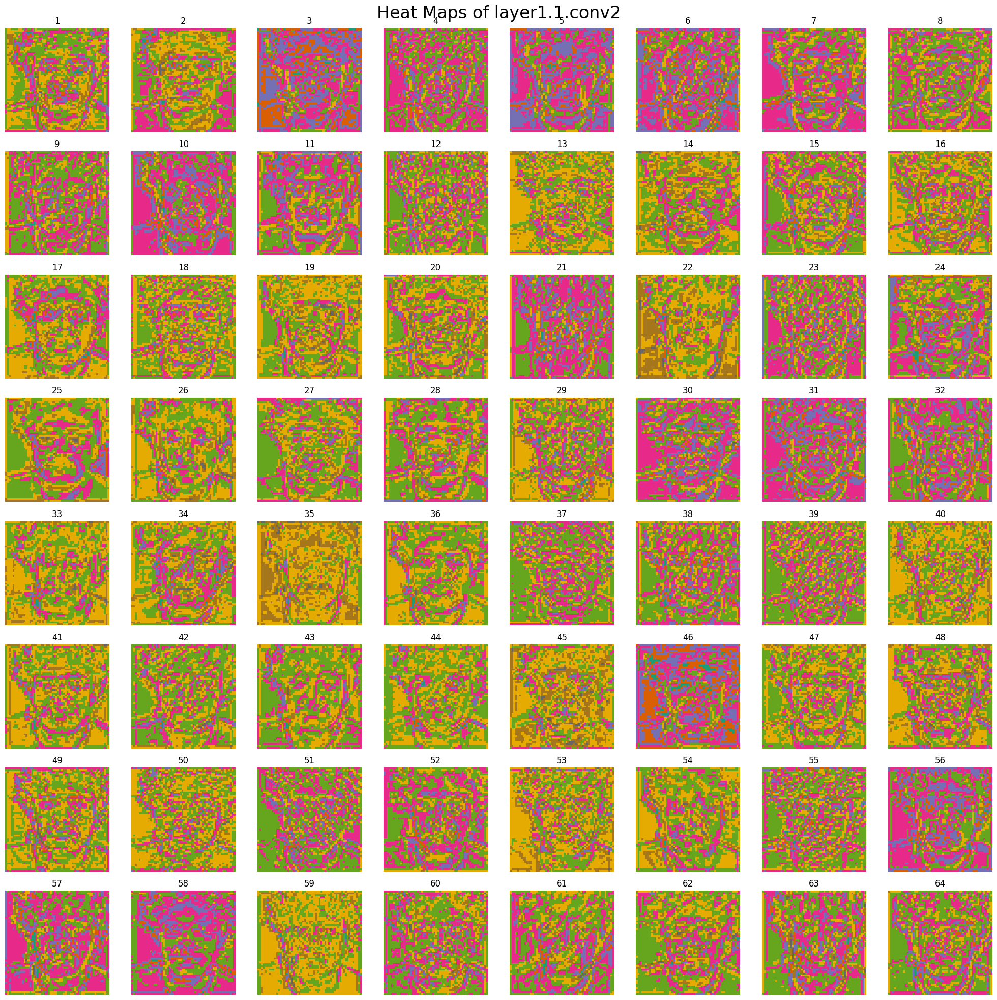

...

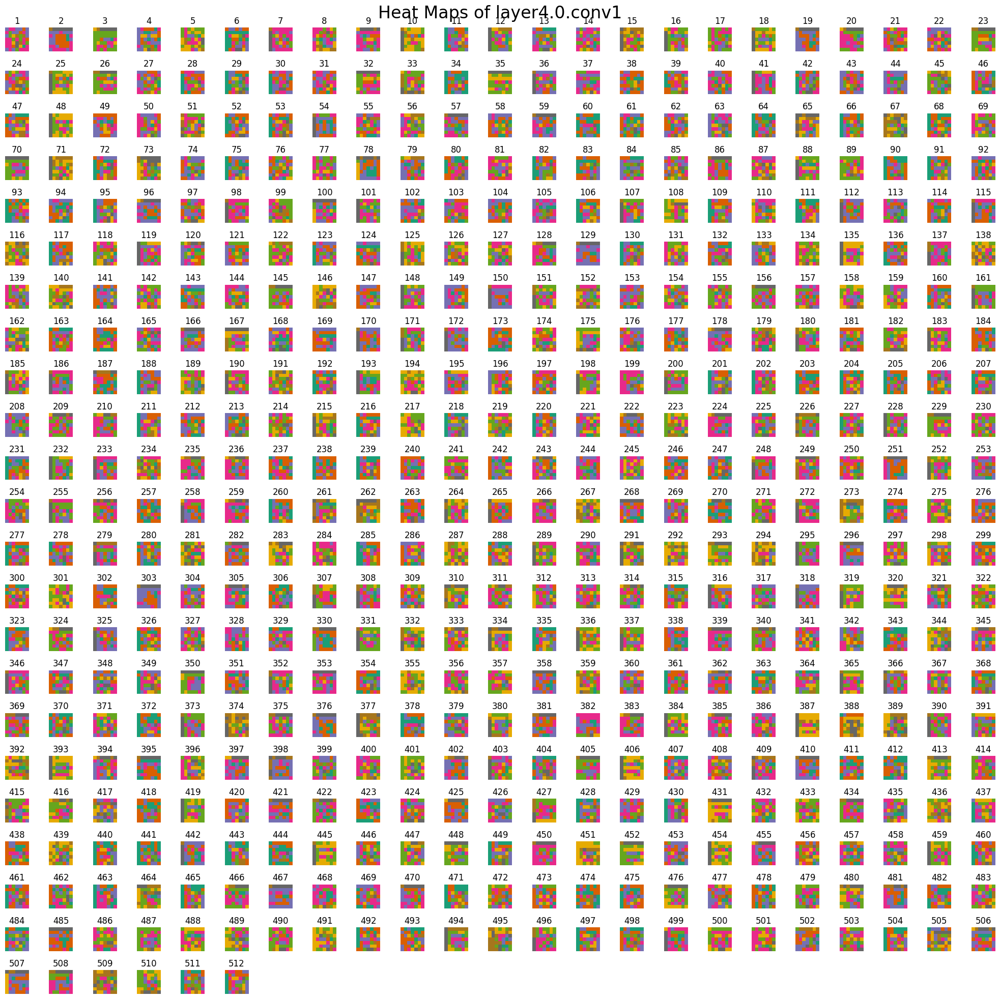

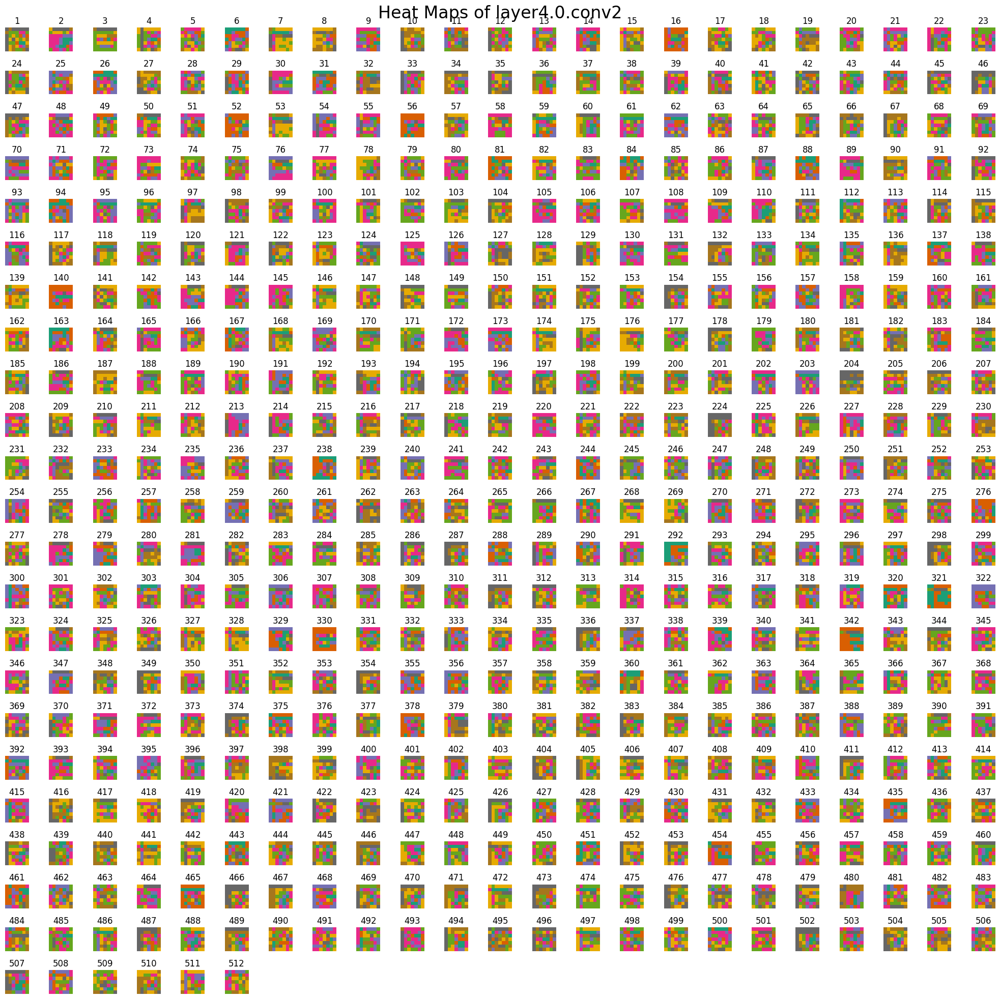

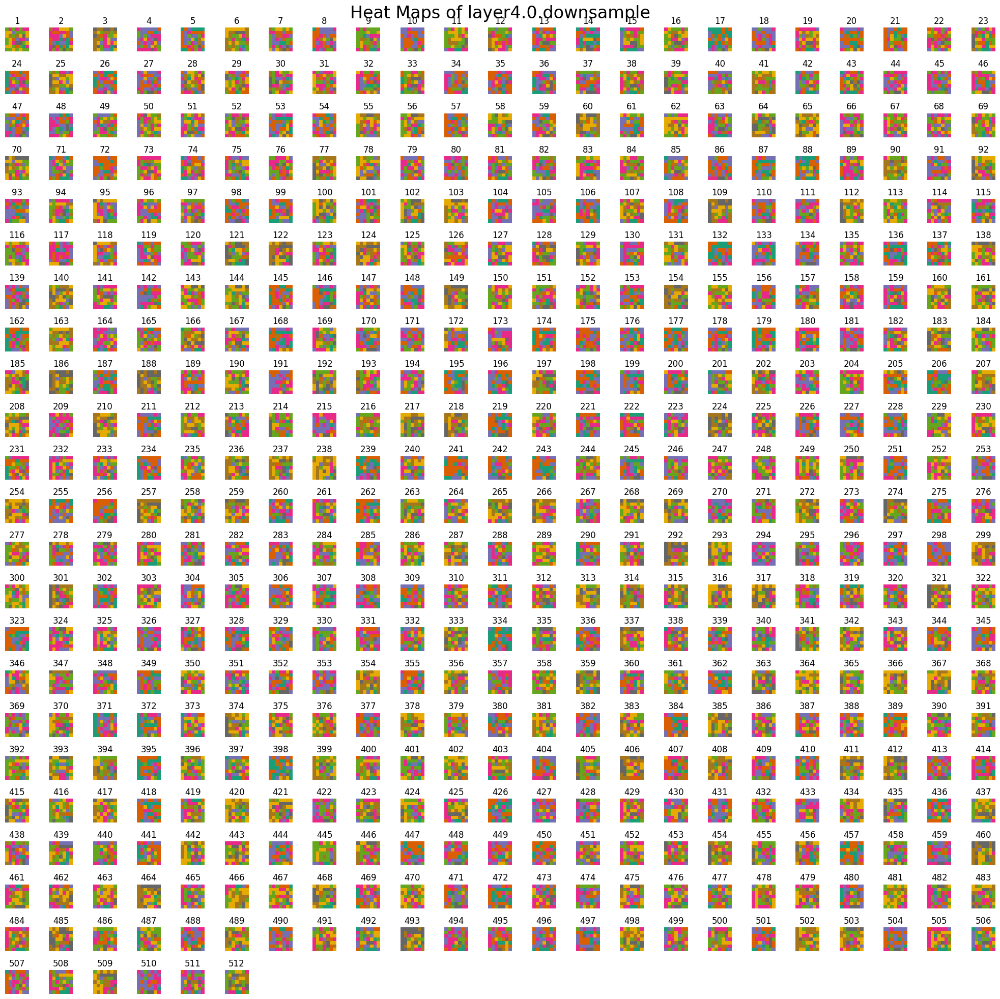

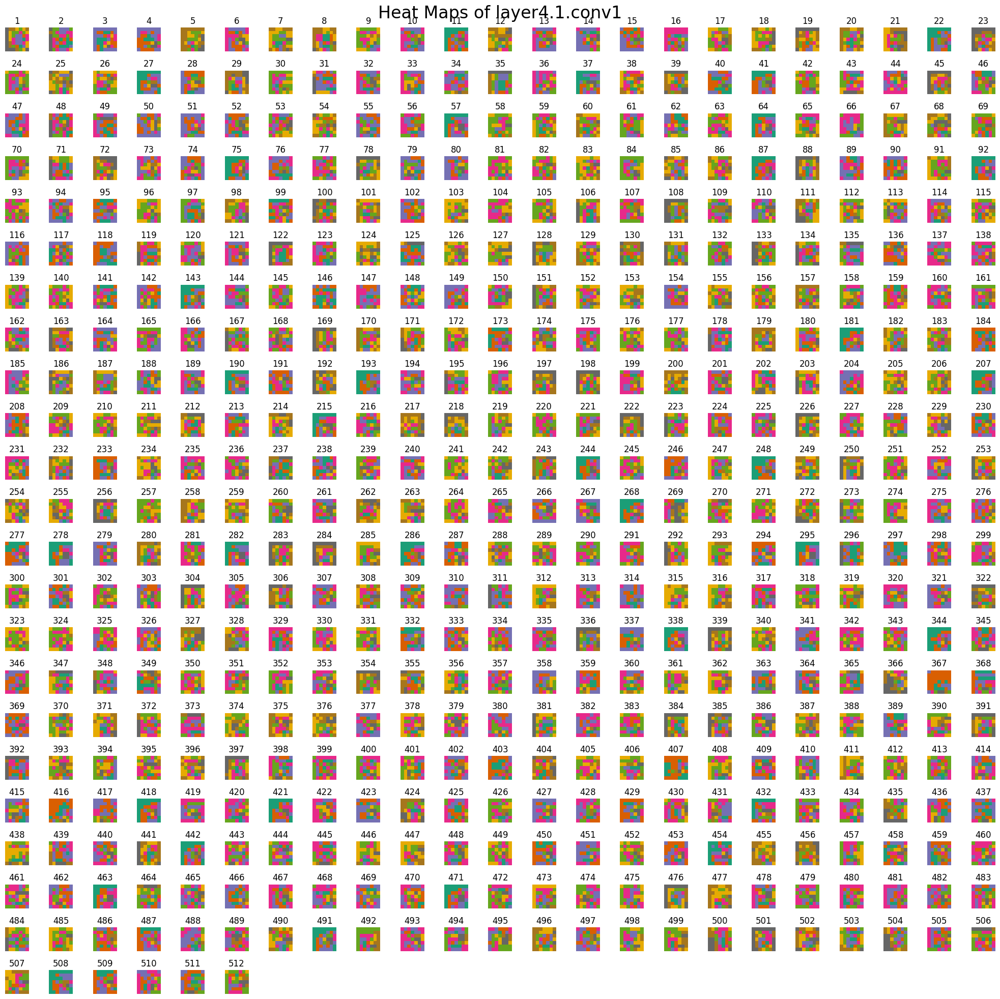

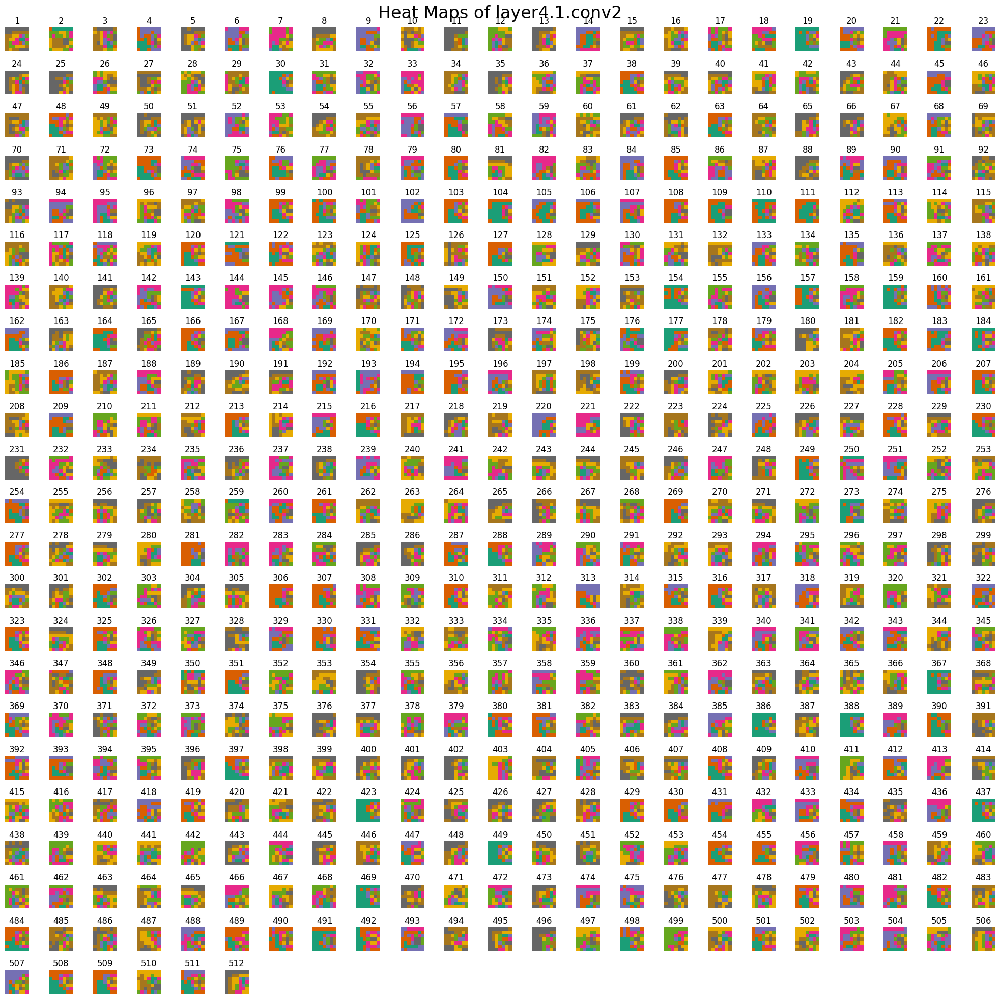

In [59]:
def visualize_all_heat_maps(model, image): # Visualize all heat maps
    model.eval() # Set the model to evaluation mode
    image = image.to(device) # Move the image to the device
    
    heat_maps = [] # List to store heat maps
    
    def hook(module, input, output): # Hook function to store heat maps
        heat_maps.append(output) # Append the output to the list

    hooks = [] # List to store hooks
    
    for layer in filters: # Loop through each layer
        hooks.append(layer.register_forward_hook(hook)) # Register the hook
    
    with torch.no_grad(): # No need to calculate gradients
        model(image) # Forward pass
    
    for hook in hooks: # Loop through each hook
        hook.remove() # Remove the hook
    
    for layer, name, heat_map in zip(filters, layer_names, heat_maps): # Loop through each layer, name, and heat map
        num_heat_maps = heat_map.size(1) # Calculate the number of heat maps
        
        grid_size = math.ceil(math.sqrt(num_heat_maps)) # Calculate the grid size
        fig, axs = plt.subplots(grid_size, grid_size, figsize=(20, 20)) # Create a figure with subplots
        fig.suptitle(f"Heat Maps of {name}", fontsize=24) # Set the title of the figure
        
        for i in range(num_heat_maps): # Loop through each heat map
            ax = axs[i // grid_size, i % grid_size] # Get the current axis
            img = heat_map[0, i].cpu() # Get the heat map and move it to the CPU
            img = (img - img.min()) / (img.max() - img.min()) # Normalize the image
            
            # Display the image
            ax.imshow(img, cmap='Dark2') # Display the image with the colormap Dark2
            ax.axis('off') # Turn off axis
            ax.set_title(f'{i+1}') # Set the title of the axis
        
        # Remove any unused subplots
        for i in range(num_heat_maps, grid_size * grid_size): # Loop through unused subplots
            fig.delaxes(axs.flatten()[i]) # Remove the subplot
        
        plt.tight_layout() # Adjust layout
        plt.show() # Show the plot
        plt.close(fig)  # Close the figure to free memory

    # Clear the heat maps list to free memory
    heat_maps.clear()

visualize_all_heat_maps(main_model_loaded, my_image_tensor)

### Occlusion Experiment

In [60]:
def process_image(model, image_tensor, device): # Process the image
    model_output = model(image_tensor.to(device)) # Forward pass
    print(f"Output shape: {model_output.shape}") # Print the output shape
    print(f"Raw output data: {model_output.data}") # Print the raw output data
    
    probabilities = F.sigmoid(model_output) # Sigmoid to get probabilities
    max_probability, prediction = torch.max(probabilities, dim=1) # Get the maximum probability and corresponding prediction
    no_occlusion_probability = max_probability[0].item() # Get the probability of no occlusion
    
    print(f"Probability of no occlusion: {no_occlusion_probability:.4f}") # Print the probability of no occlusion
    
    return prediction, no_occlusion_probability # Return the prediction and probability

prediction, no_occlusion_prob = process_image(main_model_loaded, my_image_tensor.to(device), device) # Process the image

Output shape: torch.Size([1, 1])
Raw output data: tensor([[-1.6979]], device='cuda:0')
Probability of no occlusion: 0.1547


In [61]:
def occlusion_analysis(model, image, label, occ_size=20, occ_stride=20, occ_pixel=0.5): # Occlusion analysis
    width, height = image.shape[-2], image.shape[-1] # Get the width and height of the image
    heatmap = torch.zeros((int(np.ceil((height - occ_size) / occ_stride)),  # Create a heatmap
                           int(np.ceil((width - occ_size) / occ_stride)))) # Initialize to zeros

    for h in range(0, heatmap.shape[0]): # Loop through the heatmap
        for w in range(0, heatmap.shape[1]): # Loop through the heatmap
            h_start, w_start = h * occ_stride, w * occ_stride # Calculate the start of the occlusion
            if h_start + occ_size > height or w_start + occ_size > width: continue # Skip if occlusion goes out of bounds
            input_image = image.clone().detach() # Clone and detach the image
            input_image[:, :, h_start:h_start+occ_size, w_start:w_start+occ_size] = occ_pixel # Apply occlusion
            prob = nn.functional.sigmoid(model(input_image)).tolist()[0][label] # Get the probability
            heatmap[h, w] = prob # Update the heatmap

    return heatmap

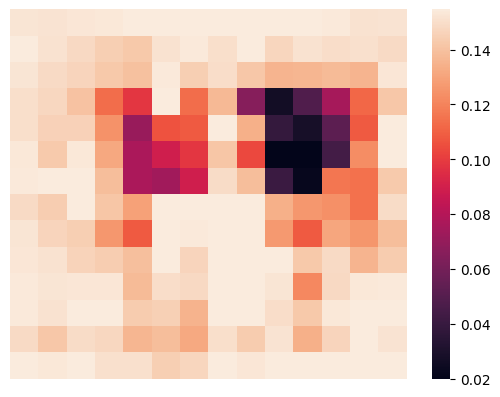

In [62]:
heatmap = occlusion_analysis(main_model_loaded, my_image_tensor.to(device), prediction[0].item(), 32, 14) # Perform occlusion analysis
imgplot = sns.heatmap(heatmap, xticklabels=False, yticklabels=False, vmax=no_occlusion_prob) # Plot the heatmap
figure = imgplot.get_figure() # Get the figure